# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return nn.functional.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [10]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()),1)
    #### END CODE HERE ####
    return combined

In [11]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [12]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [13]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [20]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [21]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [22]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 1.9135857770442963, discriminator loss: 0.3176420651301742


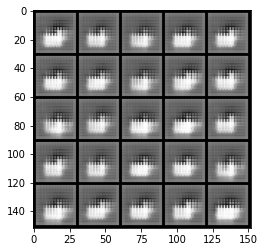

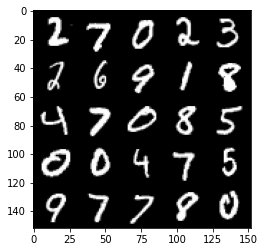

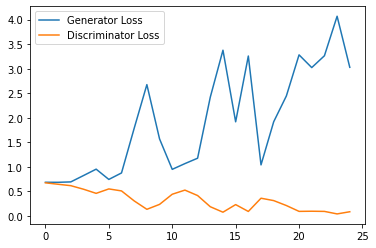

Step 1000: Generator loss: 3.4680259909629823, discriminator loss: 0.11065599948912859


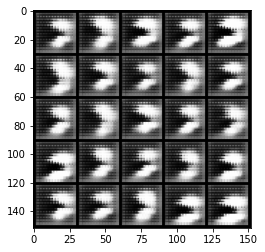

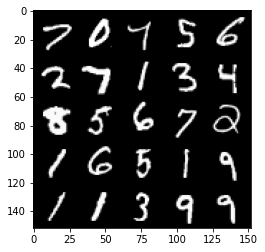

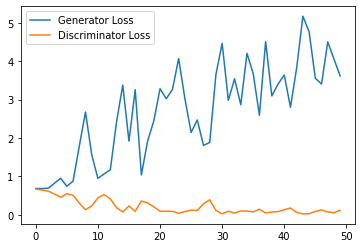

Step 1500: Generator loss: 3.9690415449142455, discriminator loss: 0.08938347469642759


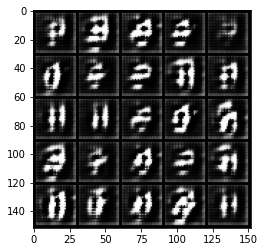

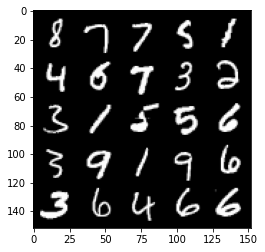

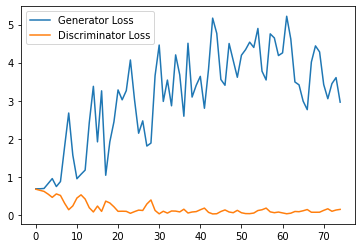

Step 2000: Generator loss: 3.256773548603058, discriminator loss: 0.14851834643632172


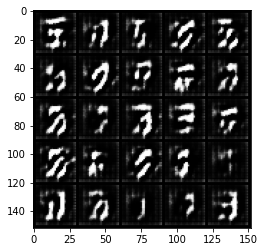

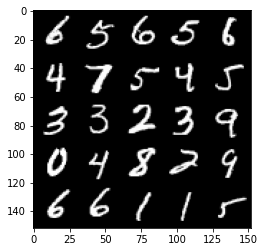

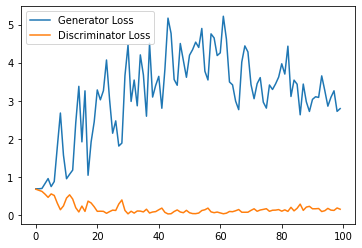

Step 2500: Generator loss: 2.608848351240158, discriminator loss: 0.22524981443583966


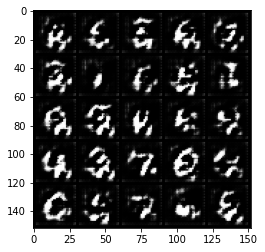

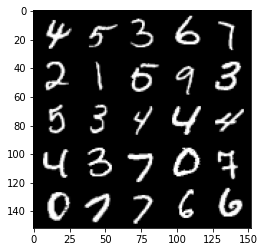

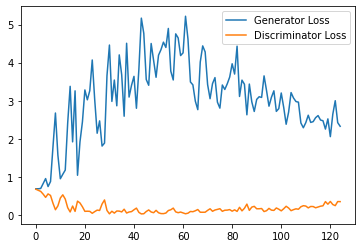

Step 3000: Generator loss: 2.1623425045013427, discriminator loss: 0.34006173768639564


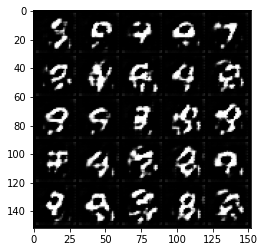

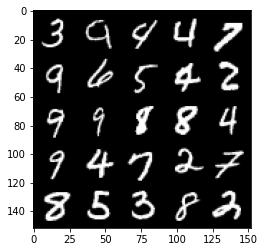

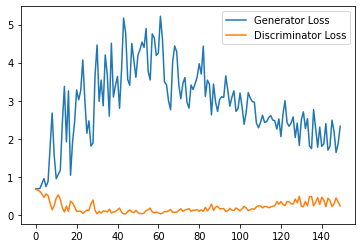

Step 3500: Generator loss: 1.9739126377105713, discriminator loss: 0.32285721412301066


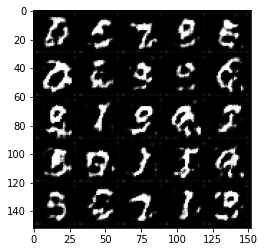

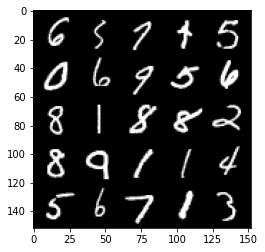

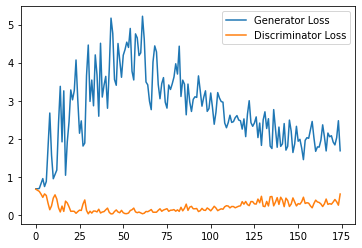

Step 4000: Generator loss: 1.9244925644397735, discriminator loss: 0.3607058164477348


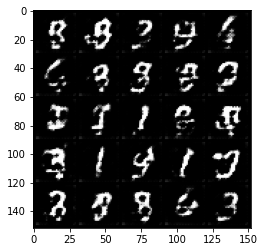

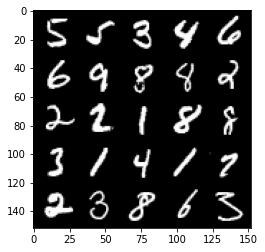

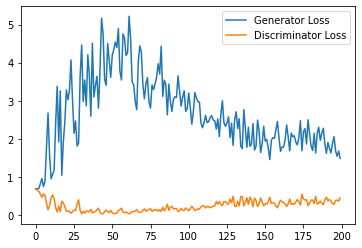

Step 4500: Generator loss: 1.7665515315532685, discriminator loss: 0.35333213064074515


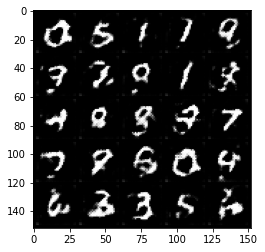

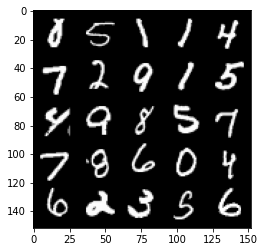

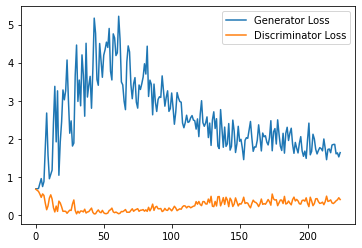

Step 5000: Generator loss: 1.7786234707832336, discriminator loss: 0.393729201823473


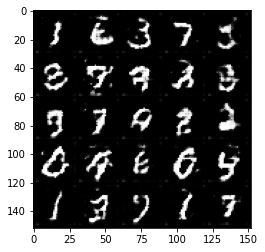

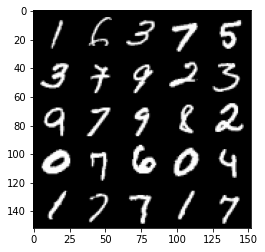

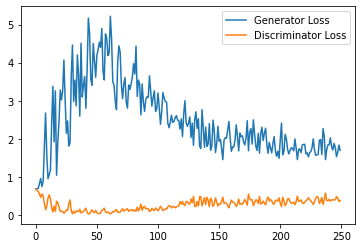

Step 5500: Generator loss: 1.652294719696045, discriminator loss: 0.4103181398510933


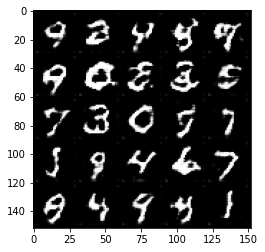

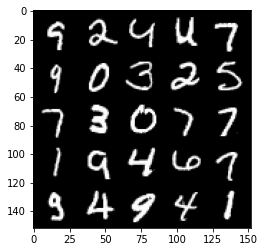

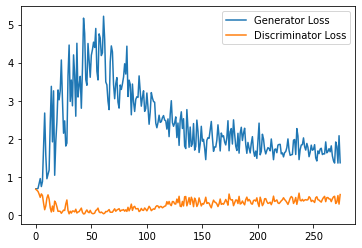

Step 6000: Generator loss: 1.5677336955070496, discriminator loss: 0.41087902104854584


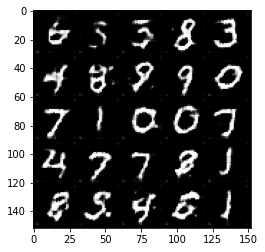

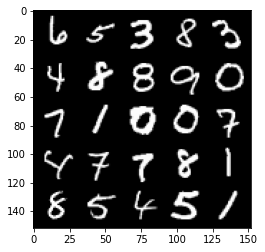

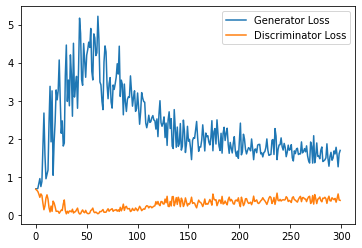

Step 6500: Generator loss: 1.5361117577552796, discriminator loss: 0.44309198212623596


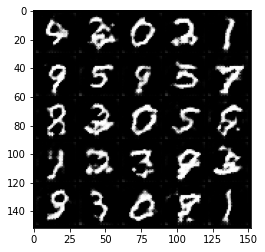

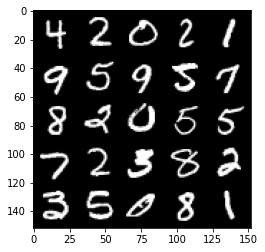

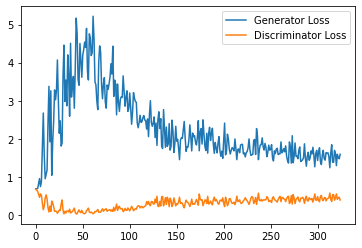

Step 7000: Generator loss: 1.4312331553697586, discriminator loss: 0.48685355806350705


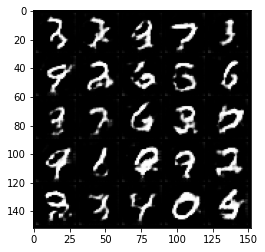

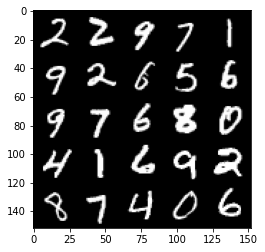

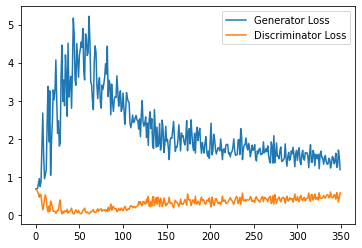

Step 7500: Generator loss: 1.3471778527498246, discriminator loss: 0.5063408541679383


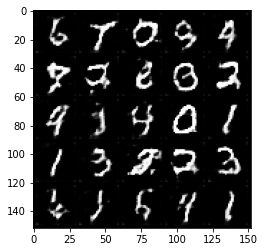

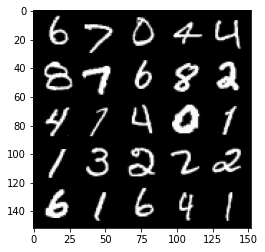

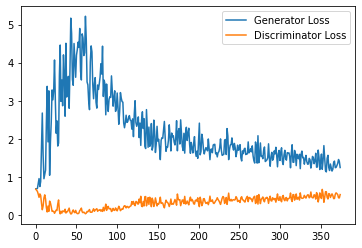

Step 8000: Generator loss: 1.3180609508752823, discriminator loss: 0.5251135641932487


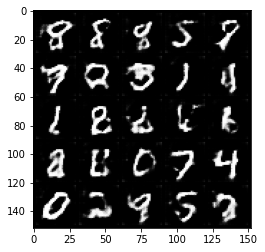

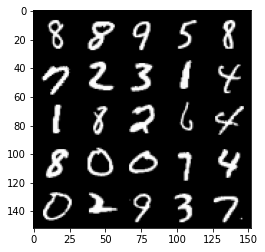

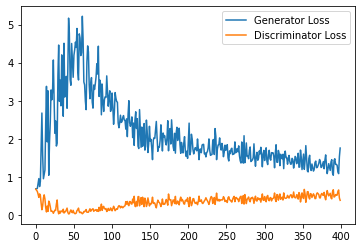

Step 8500: Generator loss: 1.2378801679611207, discriminator loss: 0.5524929291009903


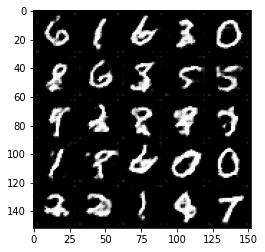

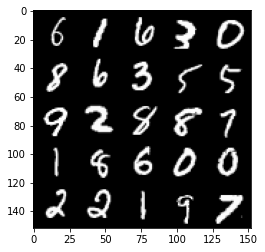

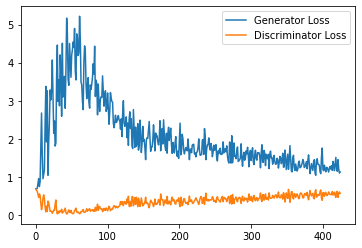

Step 9000: Generator loss: 1.24457839512825, discriminator loss: 0.56024813580513


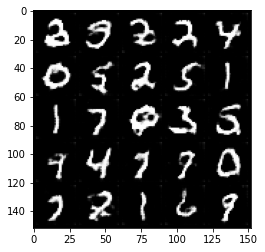

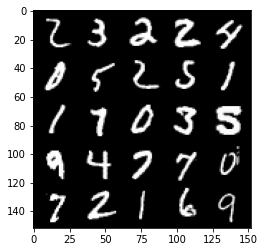

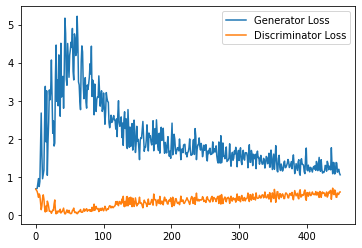

Step 9500: Generator loss: 1.1649390815496445, discriminator loss: 0.5588167392611504


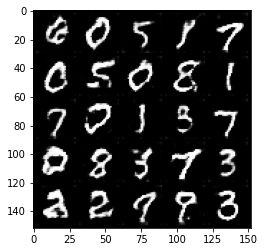

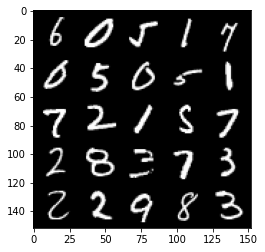

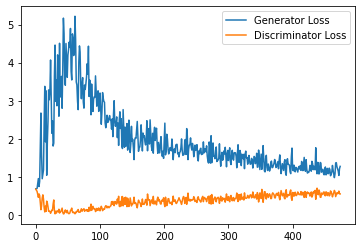

Step 10000: Generator loss: 1.1871278108358383, discriminator loss: 0.560036570250988


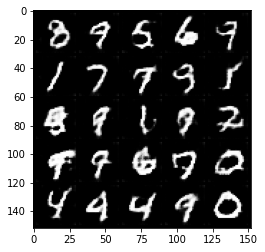

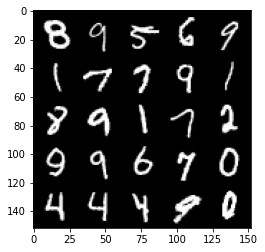

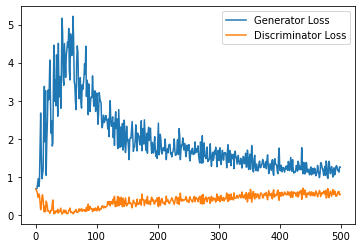

Step 10500: Generator loss: 1.1372883706092833, discriminator loss: 0.5694449119567871


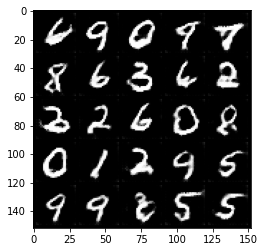

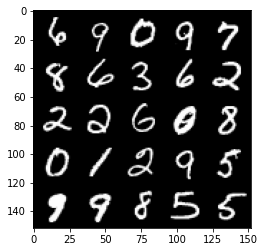

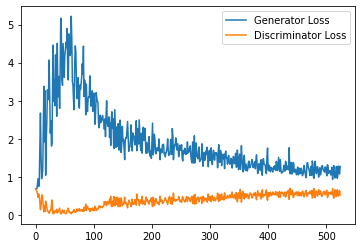

Step 11000: Generator loss: 1.1109990949630737, discriminator loss: 0.5789283385872841


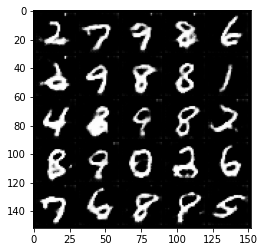

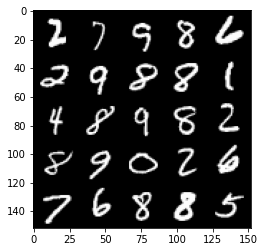

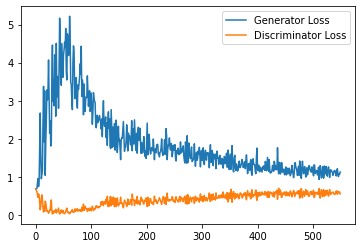

Step 11500: Generator loss: 1.0966320024728775, discriminator loss: 0.5891249749064446


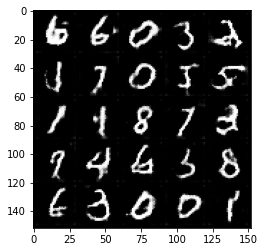

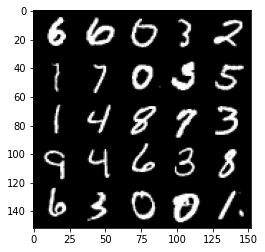

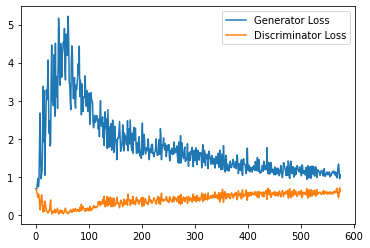

Step 12000: Generator loss: 1.0730583225488664, discriminator loss: 0.584533277273178


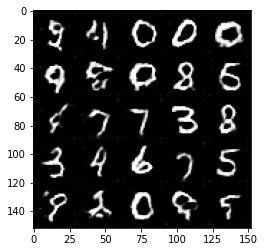

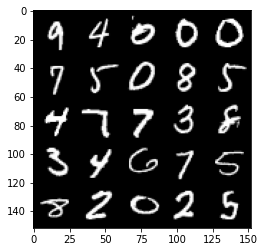

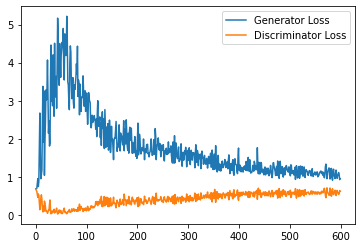

Step 12500: Generator loss: 1.070458146929741, discriminator loss: 0.5785411006808281


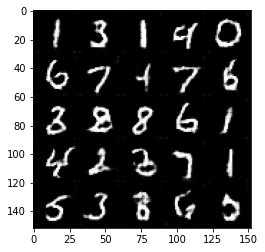

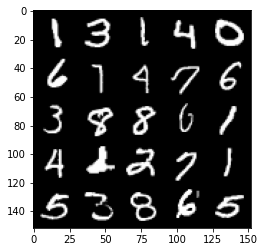

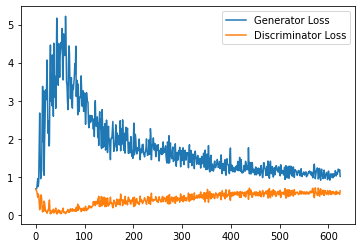

Step 13000: Generator loss: 1.0999136220216752, discriminator loss: 0.5809890891909599


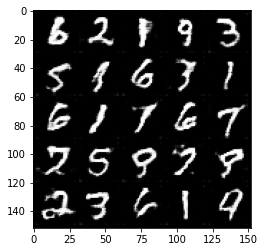

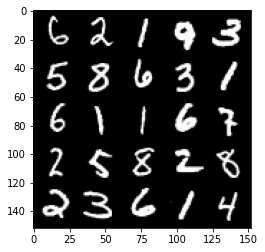

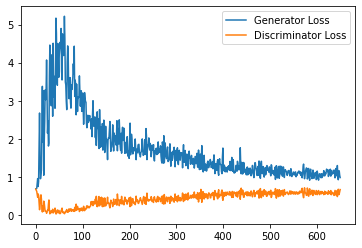

Step 13500: Generator loss: 1.088143200159073, discriminator loss: 0.5792615129947662


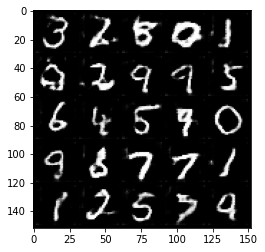

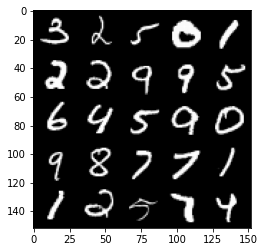

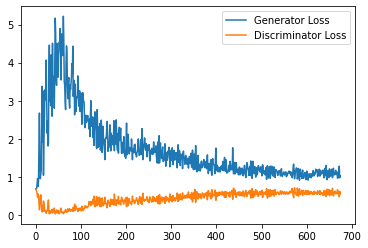

Step 14000: Generator loss: 1.02787060713768, discriminator loss: 0.5862749269604683


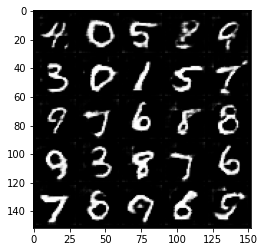

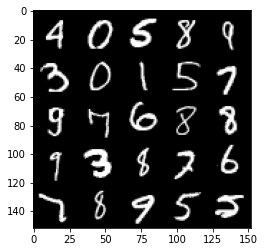

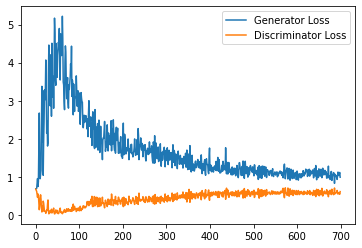

Step 14500: Generator loss: 1.0539392315149307, discriminator loss: 0.5843219204545022


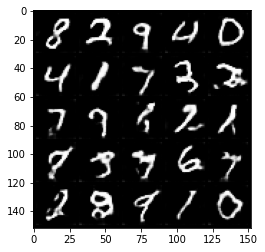

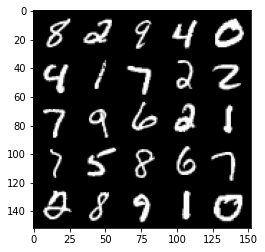

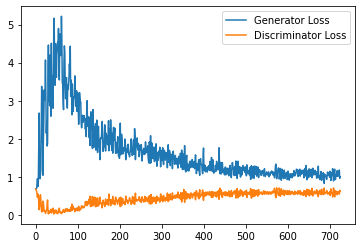

Step 15000: Generator loss: 1.0389407832622528, discriminator loss: 0.6000309951901436


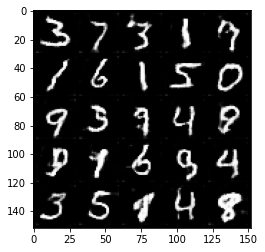

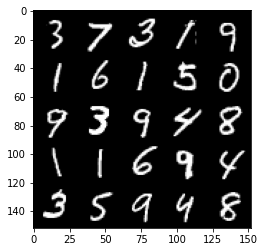

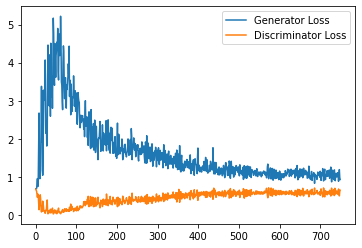

Step 15500: Generator loss: 1.0809616471529007, discriminator loss: 0.5798579278588295


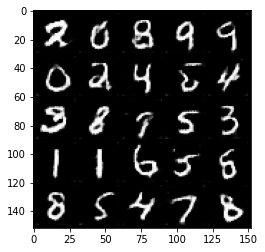

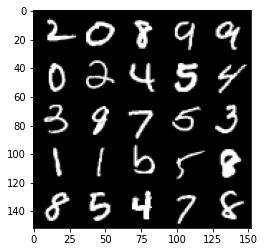

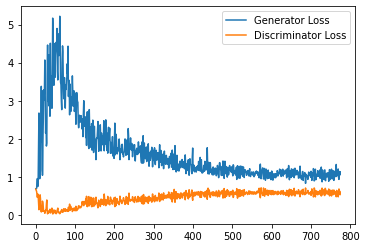

Step 16000: Generator loss: 1.0363385202884674, discriminator loss: 0.5942839488387108


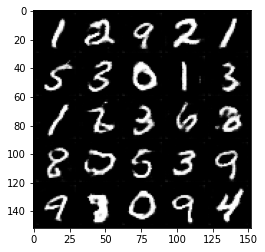

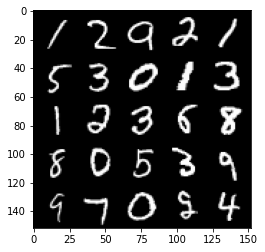

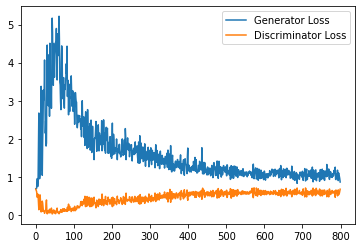

Step 16500: Generator loss: 0.9965077420473099, discriminator loss: 0.5974276626706123


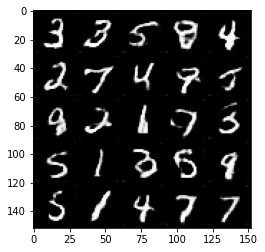

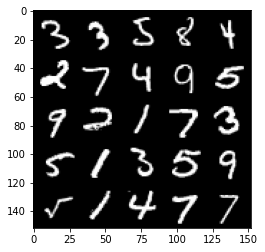

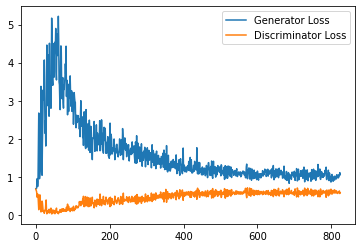

Step 17000: Generator loss: 1.0538042746782303, discriminator loss: 0.5865531811118125


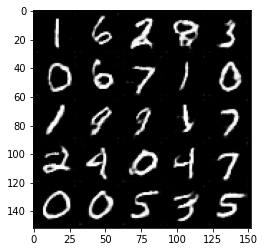

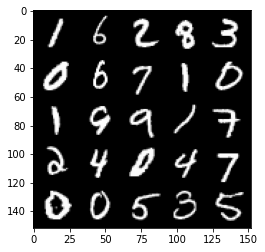

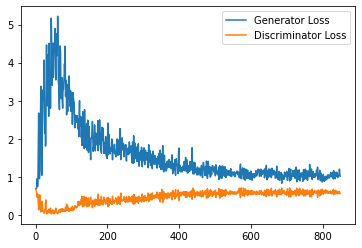

Step 17500: Generator loss: 1.0425377395153046, discriminator loss: 0.5913968379497528


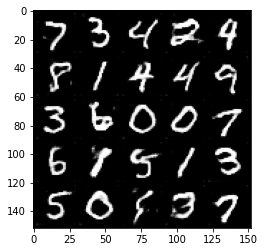

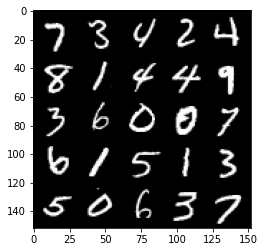

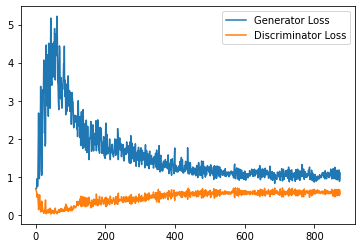

Step 18000: Generator loss: 1.0205624890327454, discriminator loss: 0.5921424225568771


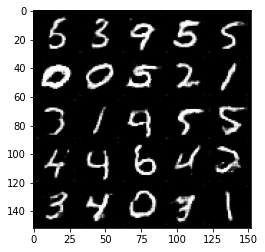

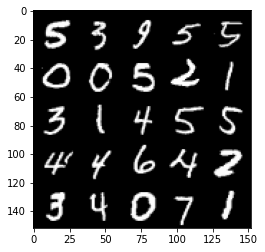

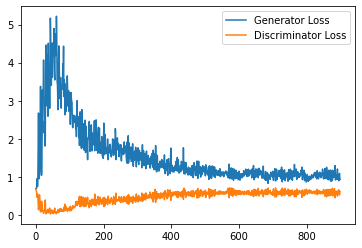

Step 18500: Generator loss: 1.005360770702362, discriminator loss: 0.593455145418644


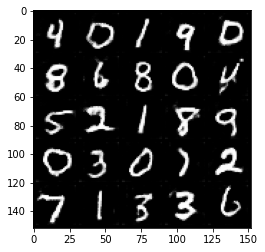

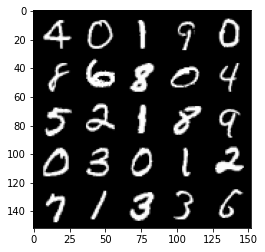

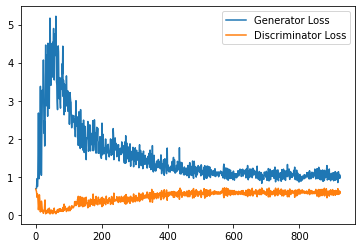

Step 19000: Generator loss: 1.034543038368225, discriminator loss: 0.589904512822628


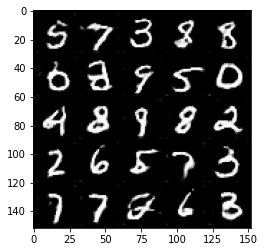

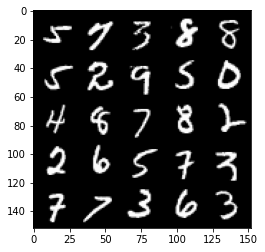

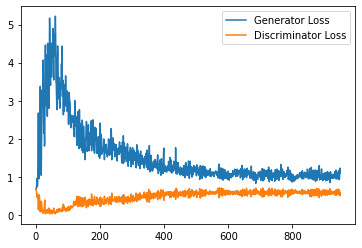

Step 19500: Generator loss: 1.0258280093669891, discriminator loss: 0.5918333388566971


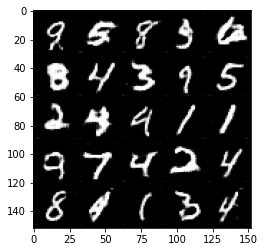

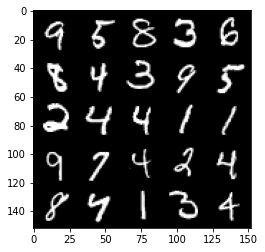

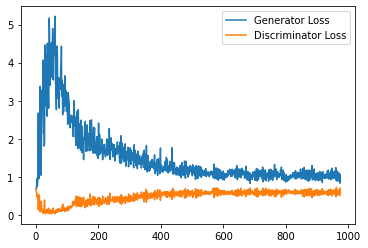

Step 20000: Generator loss: 0.9852449313402176, discriminator loss: 0.5970320021510124


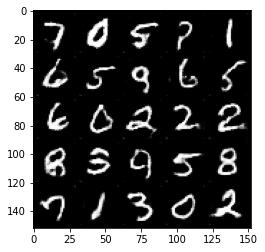

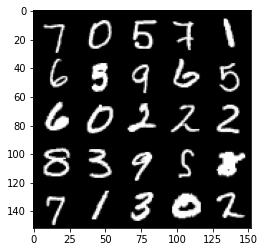

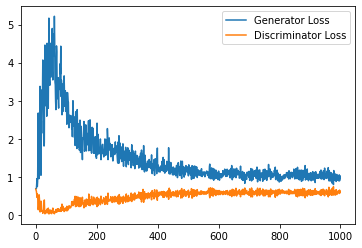

Step 20500: Generator loss: 0.9969216941595077, discriminator loss: 0.5930086413025856


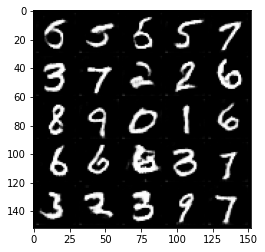

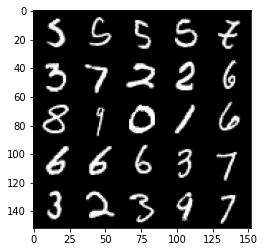

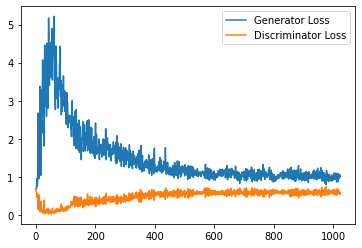

Step 21000: Generator loss: 0.9998356875181198, discriminator loss: 0.5920227000117302


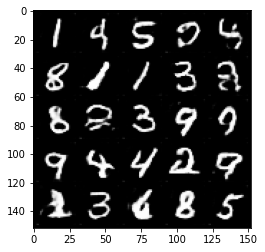

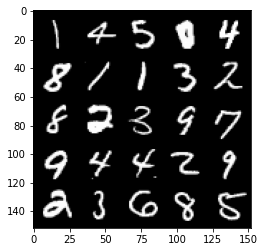

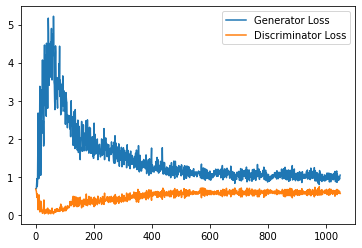

Step 21500: Generator loss: 1.0070535708665849, discriminator loss: 0.5906726130843163


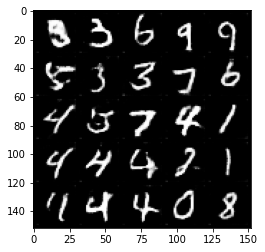

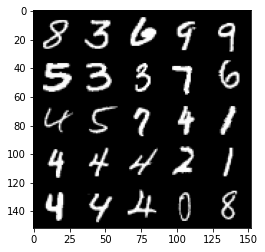

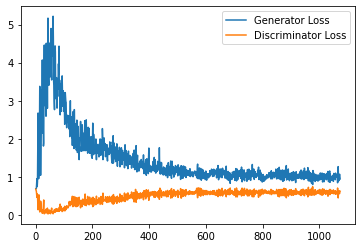

Step 22000: Generator loss: 1.0212367404699325, discriminator loss: 0.5841962462067604


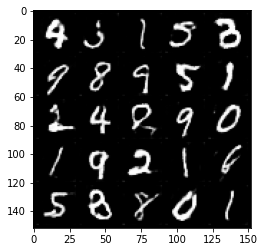

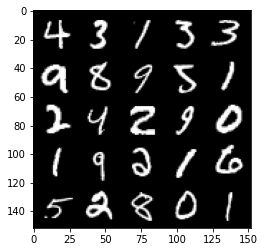

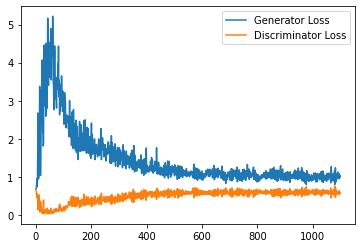

Step 22500: Generator loss: 0.9879933553934097, discriminator loss: 0.5947896023988724


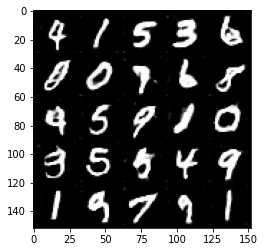

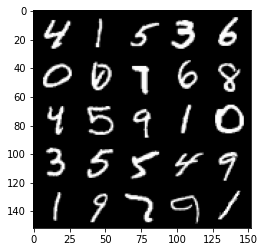

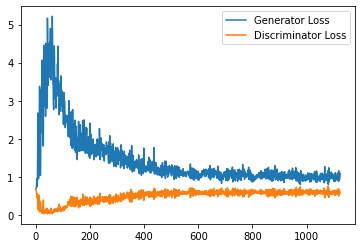

Step 23000: Generator loss: 1.0026284871101379, discriminator loss: 0.5906990593671799


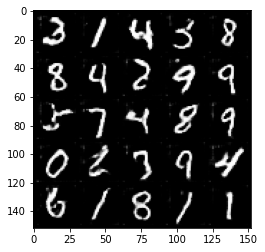

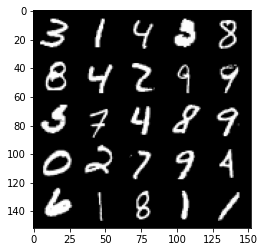

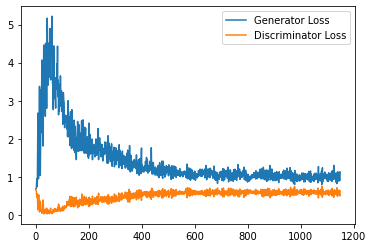

Step 23500: Generator loss: 0.9745275827646256, discriminator loss: 0.594872169494629


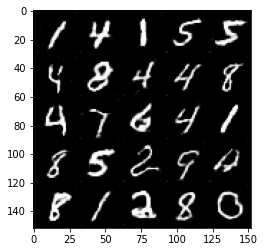

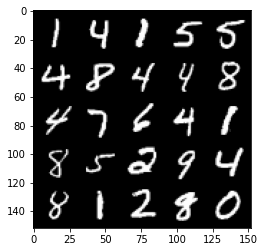

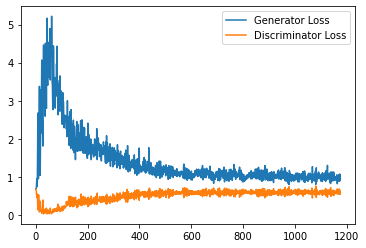

Step 24000: Generator loss: 1.0558631784915924, discriminator loss: 0.5923937947750092


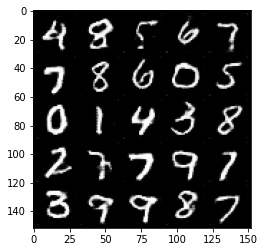

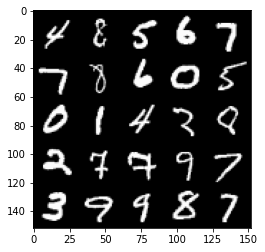

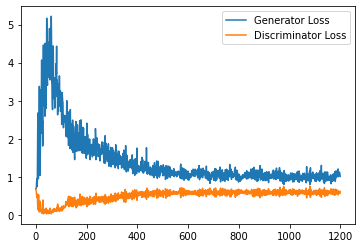

Step 24500: Generator loss: 1.008857884645462, discriminator loss: 0.5924575428962707


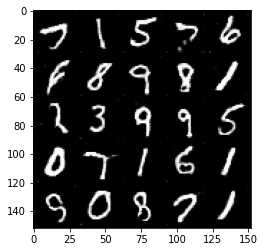

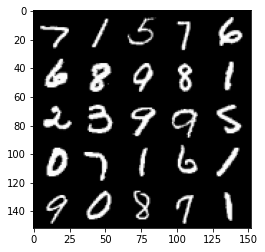

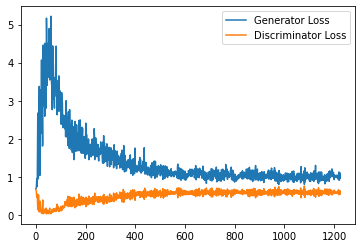

Step 25000: Generator loss: 0.995501384973526, discriminator loss: 0.5959547145962715


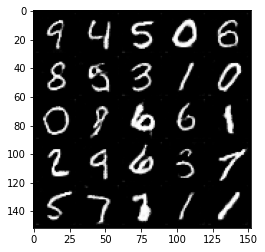

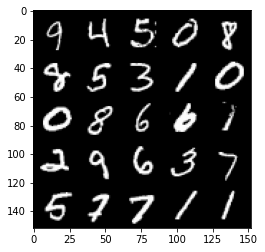

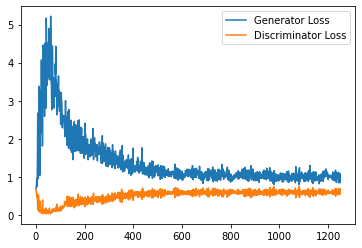

Step 25500: Generator loss: 0.9883789377212524, discriminator loss: 0.5913108968734742


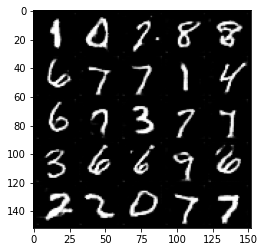

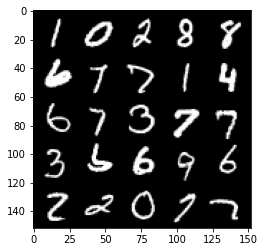

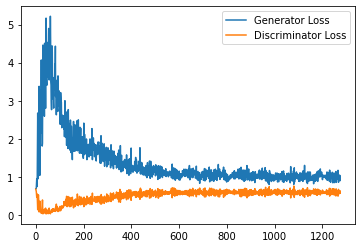

Step 26000: Generator loss: 0.9825151393413544, discriminator loss: 0.5912788136601448


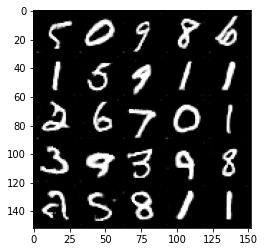

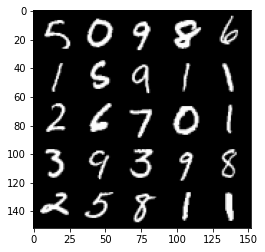

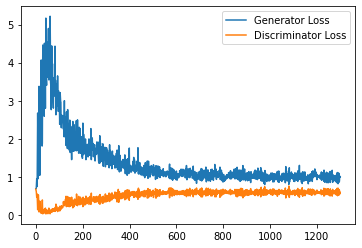

Step 26500: Generator loss: 0.9928360207080841, discriminator loss: 0.5957247846126557


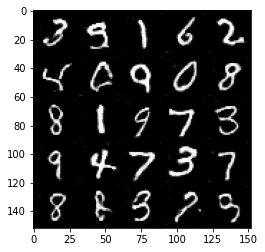

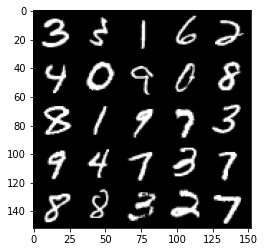

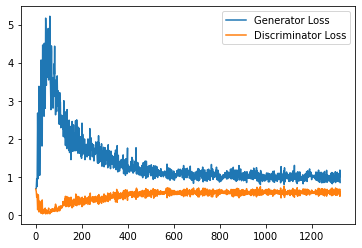

Step 27000: Generator loss: 0.9780217405557633, discriminator loss: 0.5901316544413566


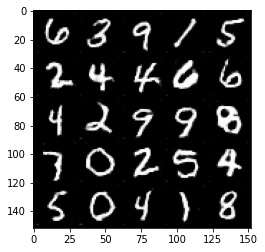

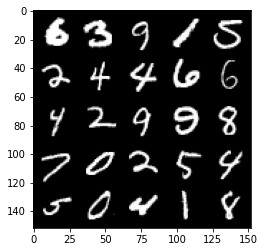

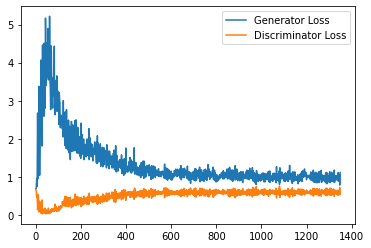

Step 27500: Generator loss: 1.0035893274545669, discriminator loss: 0.5857363028526306


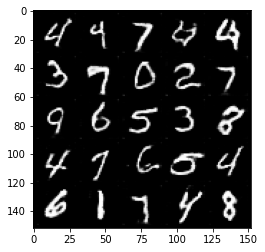

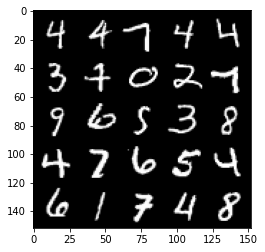

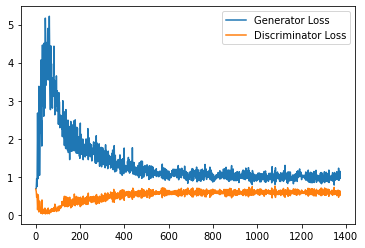

Step 28000: Generator loss: 1.0060600556135177, discriminator loss: 0.5905873298645019


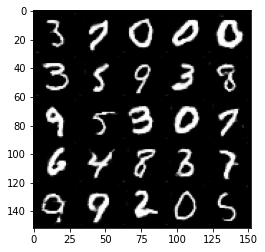

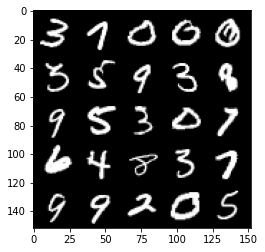

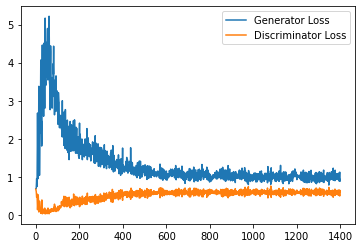

Step 28500: Generator loss: 1.0035119762420655, discriminator loss: 0.5888763278722763


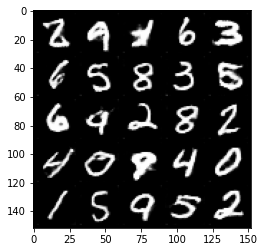

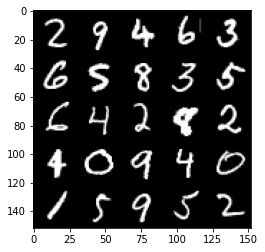

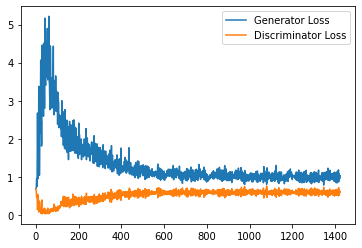

Step 29000: Generator loss: 0.9849663716554642, discriminator loss: 0.5925271324515343


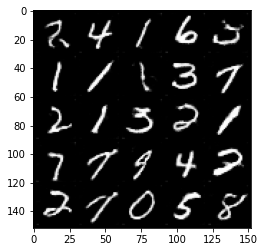

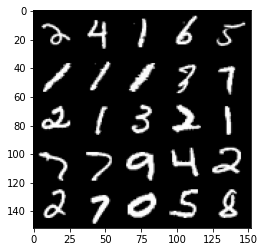

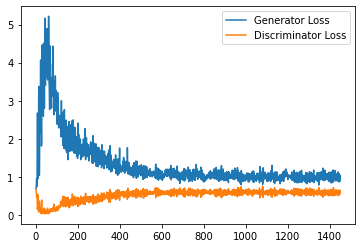

Step 29500: Generator loss: 0.9957586948871613, discriminator loss: 0.5901117918491363


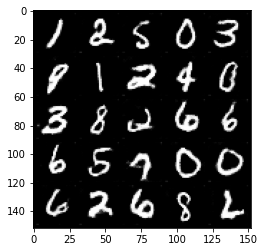

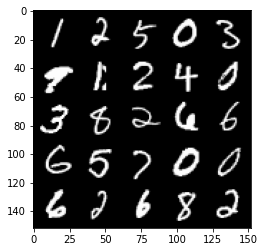

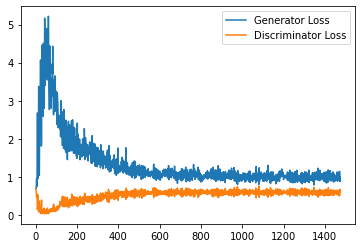

Step 30000: Generator loss: 0.9976540511846542, discriminator loss: 0.5874437639713287


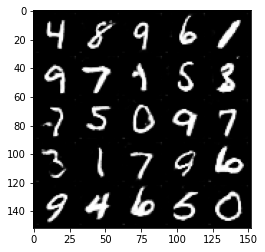

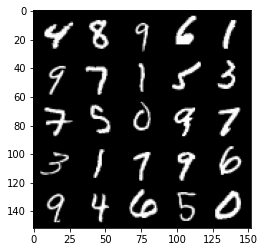

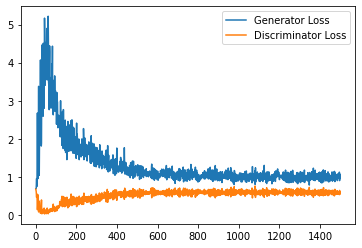

Step 30500: Generator loss: 0.9874235299825669, discriminator loss: 0.5897834706902504


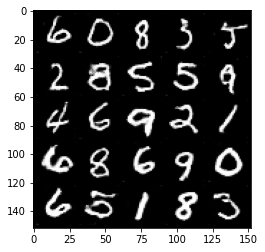

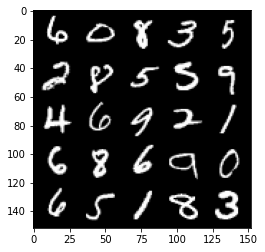

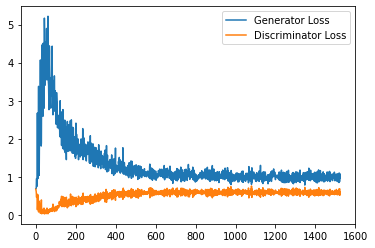

Step 31000: Generator loss: 1.0086669805049897, discriminator loss: 0.5841569556593895


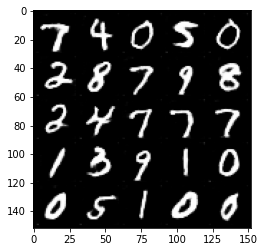

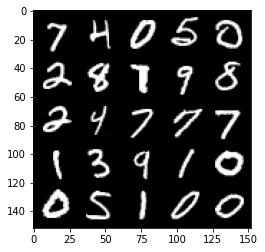

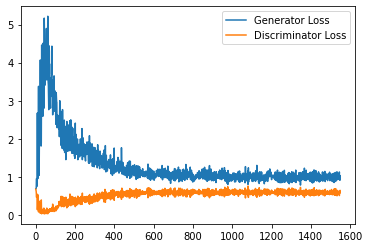

Step 31500: Generator loss: 0.9956464360952377, discriminator loss: 0.5815635353922844


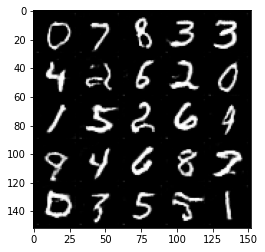

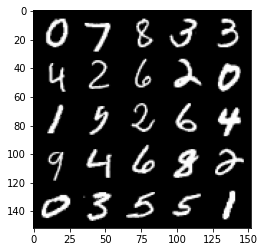

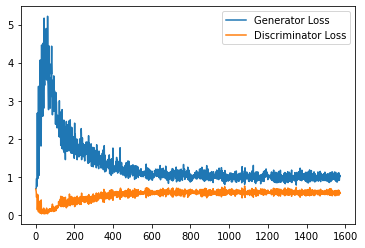

Step 32000: Generator loss: 1.002574226975441, discriminator loss: 0.5894306673407554


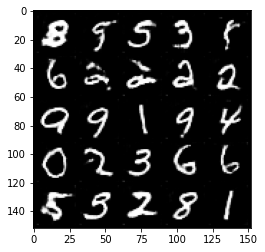

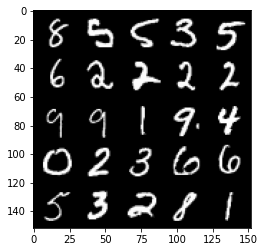

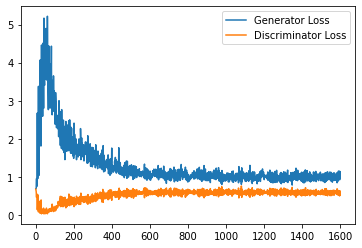

Step 32500: Generator loss: 1.014492071032524, discriminator loss: 0.5861904086470604


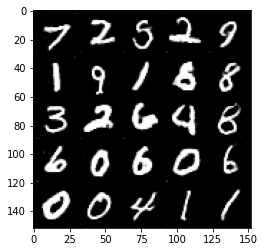

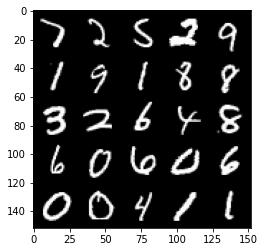

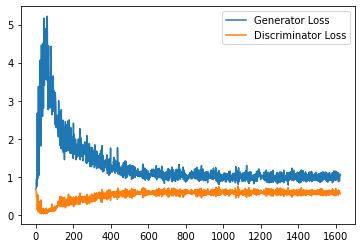

Step 33000: Generator loss: 0.9960478284358978, discriminator loss: 0.5851668055057526


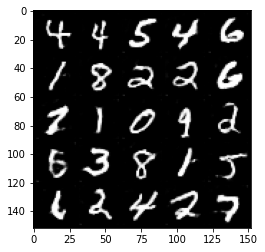

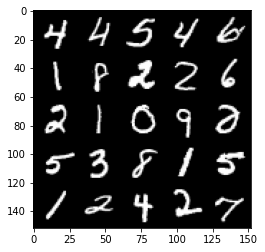

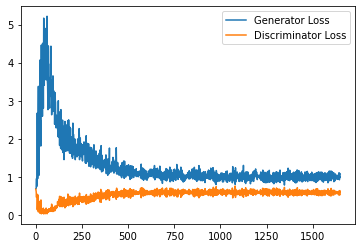

Step 33500: Generator loss: 0.9909177145957947, discriminator loss: 0.5880387774705886


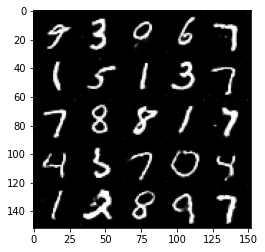

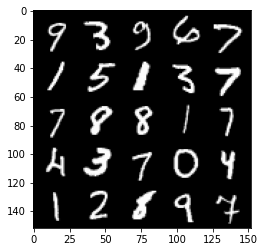

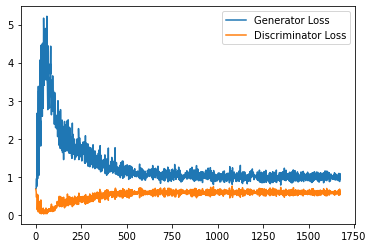

Step 34000: Generator loss: 1.0127084238529205, discriminator loss: 0.58729386562109


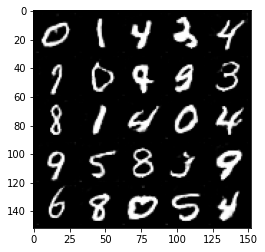

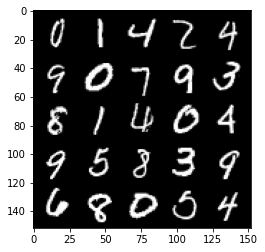

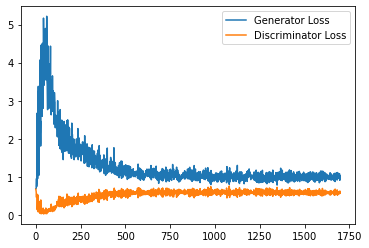

Step 34500: Generator loss: 0.9962076355218887, discriminator loss: 0.5882333337664604


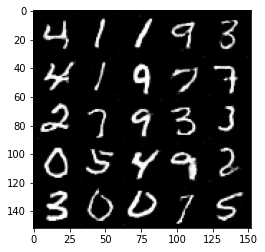

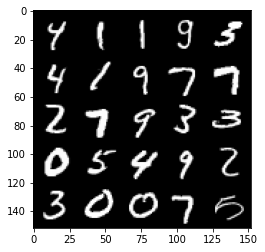

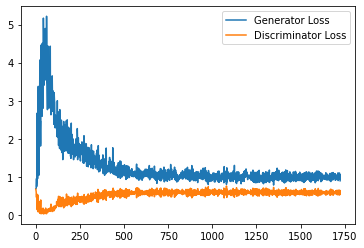

Step 35000: Generator loss: 0.9919205650091171, discriminator loss: 0.5861801786422729


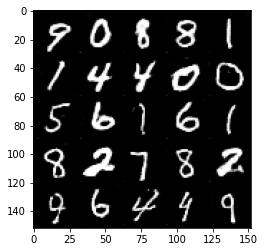

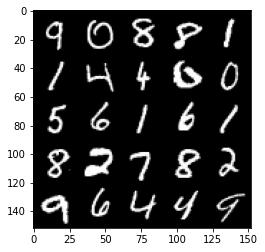

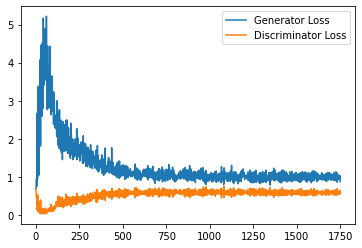

Step 35500: Generator loss: 1.0036950390338897, discriminator loss: 0.580521843791008


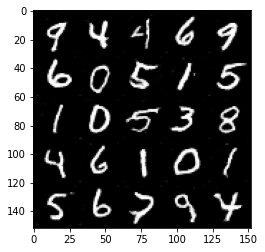

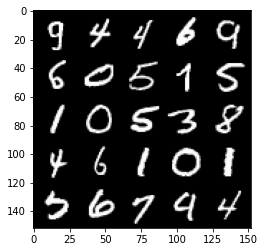

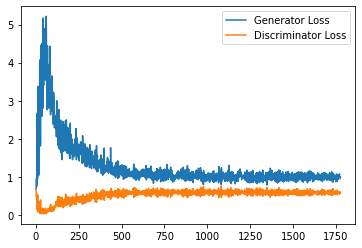

Step 36000: Generator loss: 1.0228099690675736, discriminator loss: 0.5859016496539116


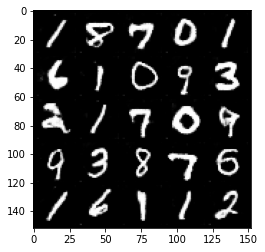

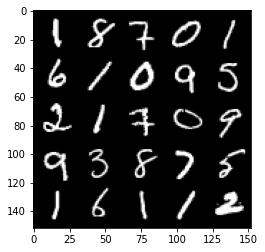

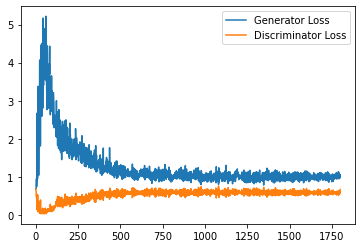

Step 36500: Generator loss: 1.0163352729082107, discriminator loss: 0.5774957593679428


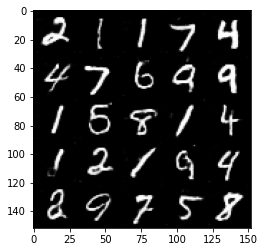

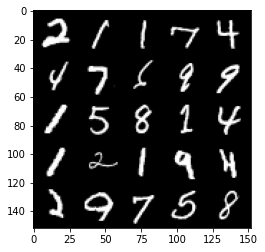

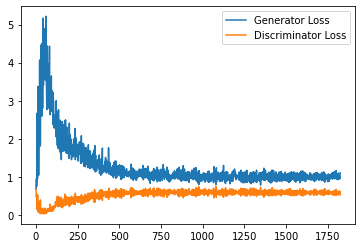

Step 37000: Generator loss: 1.0160925987958909, discriminator loss: 0.5828599047064781


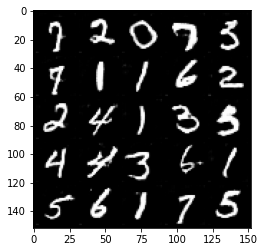

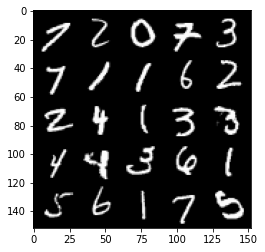

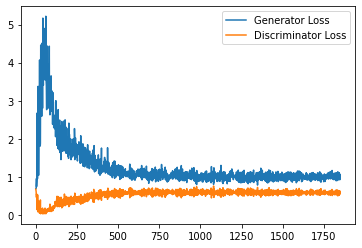

Step 37500: Generator loss: 1.0189249751567842, discriminator loss: 0.5818404662013054


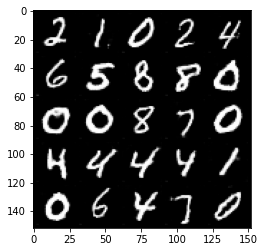

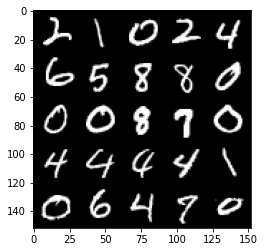

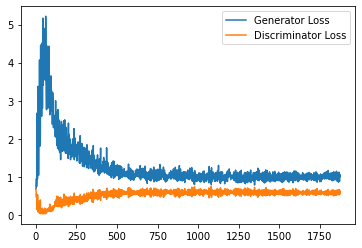

Step 38000: Generator loss: 1.032946347117424, discriminator loss: 0.5799920474290847


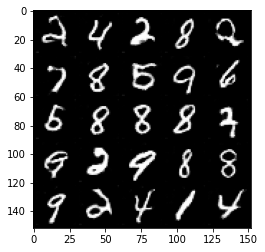

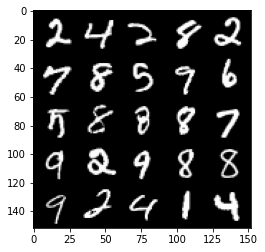

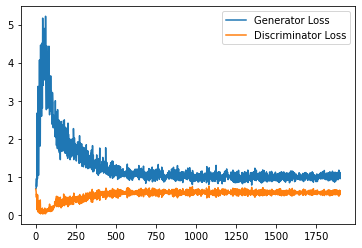

Step 38500: Generator loss: 1.011314978837967, discriminator loss: 0.5801576391458512


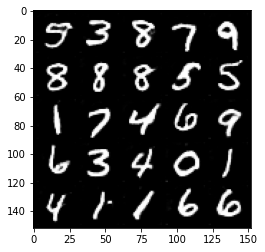

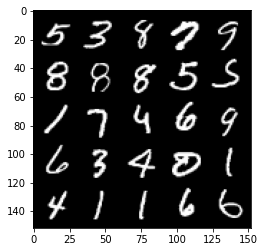

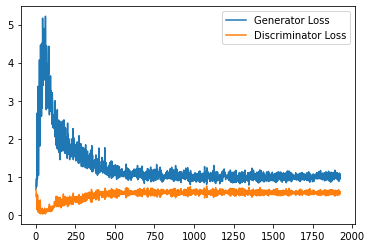

Step 39000: Generator loss: 1.0114755133390427, discriminator loss: 0.5813215661048889


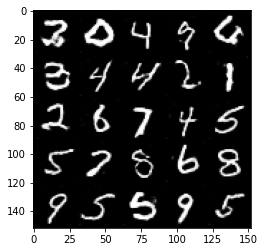

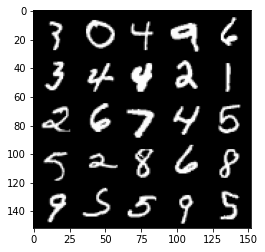

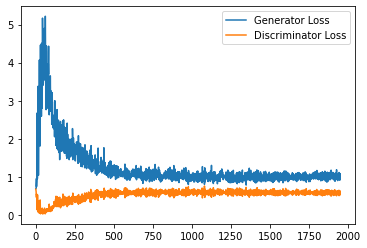

Step 39500: Generator loss: 1.0110471118688584, discriminator loss: 0.5841052216887475


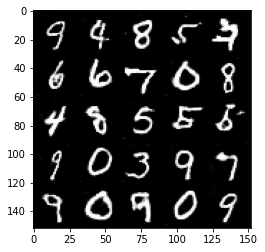

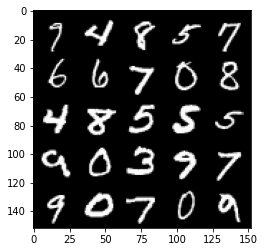

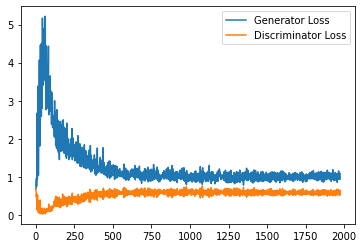

Step 40000: Generator loss: 1.0233899208307267, discriminator loss: 0.5821555749773979


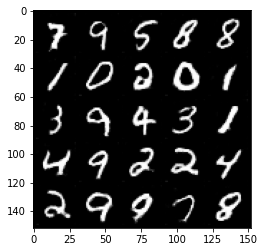

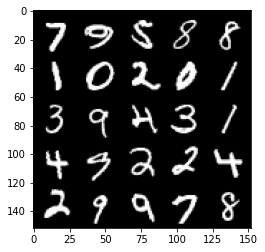

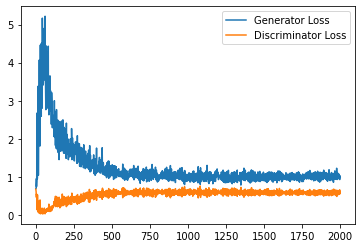

Step 40500: Generator loss: 1.0305964690446854, discriminator loss: 0.5833639022111893


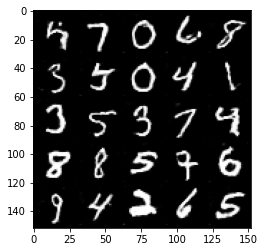

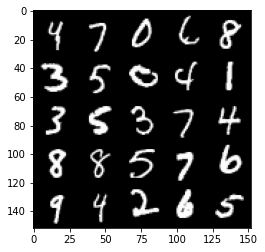

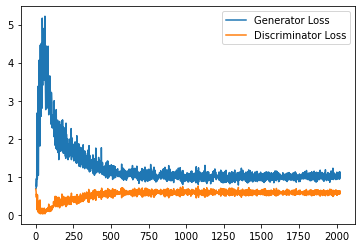

Step 41000: Generator loss: 1.0274578957557678, discriminator loss: 0.5748836388587951


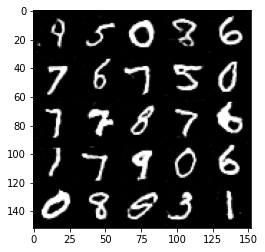

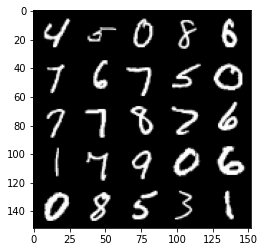

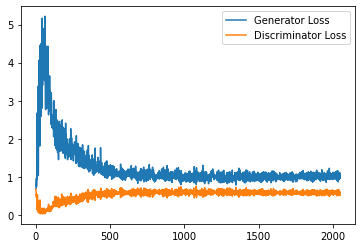

Step 41500: Generator loss: 1.0178437279462815, discriminator loss: 0.5844273847341538


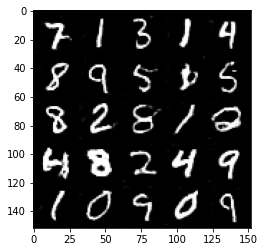

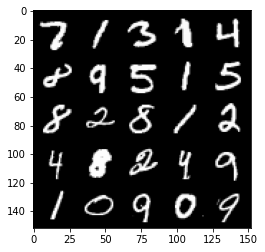

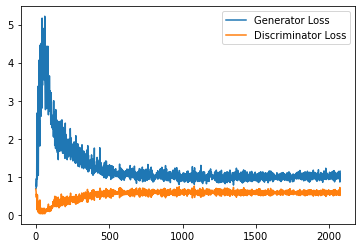

Step 42000: Generator loss: 1.0135459554195405, discriminator loss: 0.5820696133971214


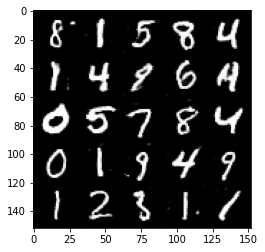

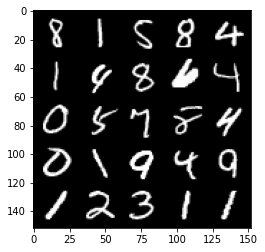

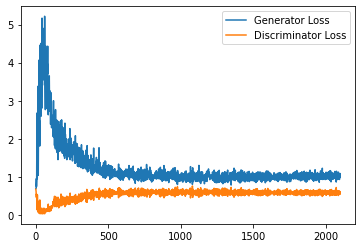

Step 42500: Generator loss: 1.0335172975063325, discriminator loss: 0.5763823963403701


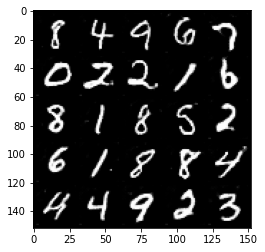

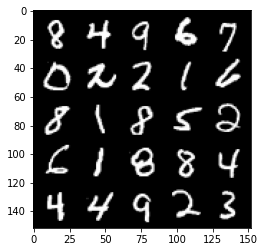

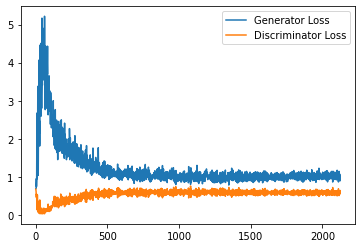

Step 43000: Generator loss: 1.0424465475082398, discriminator loss: 0.5770573095083237


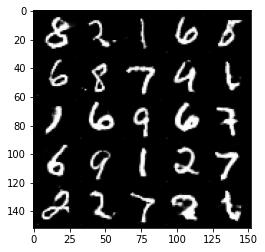

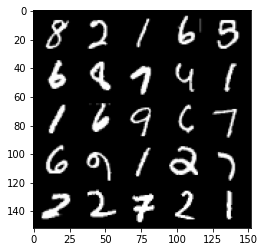

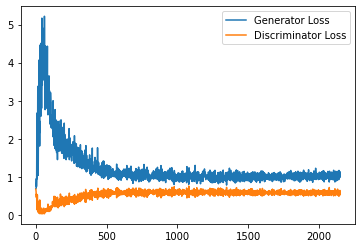

Step 43500: Generator loss: 1.0234740790128707, discriminator loss: 0.5822761904597282


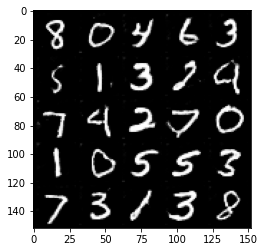

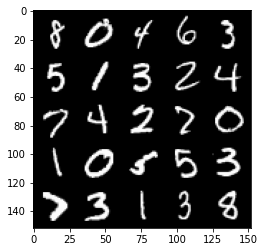

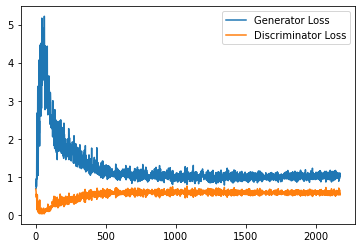

Step 44000: Generator loss: 1.022902335882187, discriminator loss: 0.5862975884675979


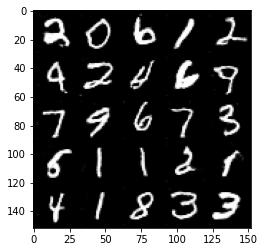

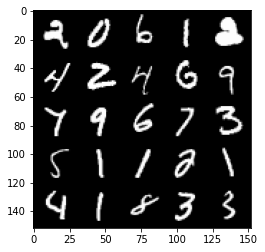

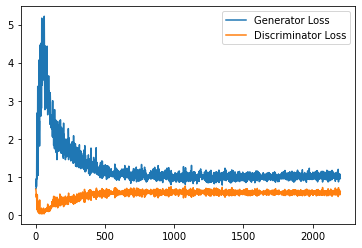

Step 44500: Generator loss: 1.0176937834024429, discriminator loss: 0.576254814863205


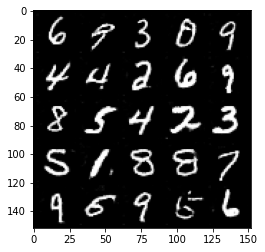

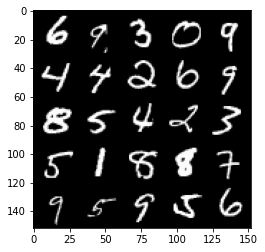

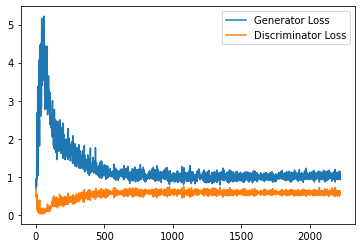

Step 45000: Generator loss: 1.0408008623123168, discriminator loss: 0.5745446200966835


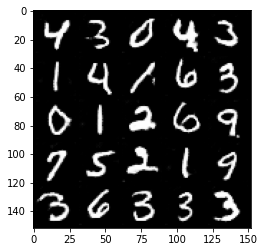

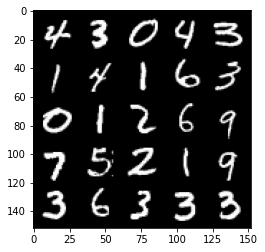

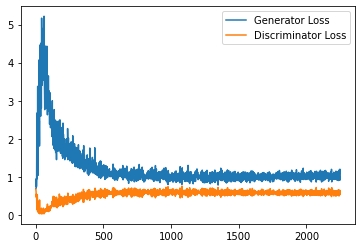

Step 45500: Generator loss: 1.0352129164934158, discriminator loss: 0.572173438668251


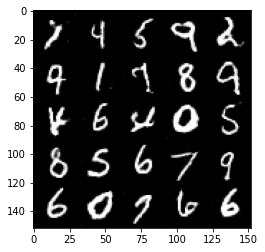

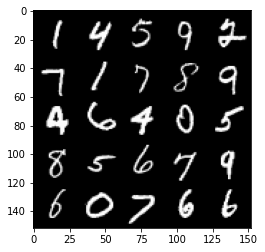

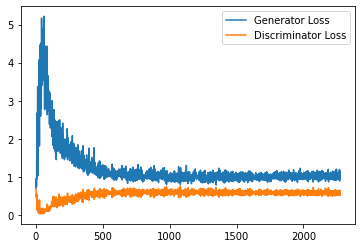

Step 46000: Generator loss: 1.0361485596895217, discriminator loss: 0.5785406489372253


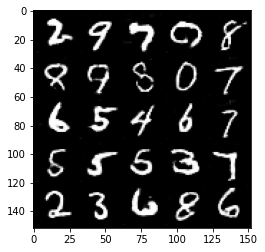

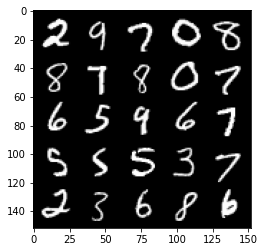

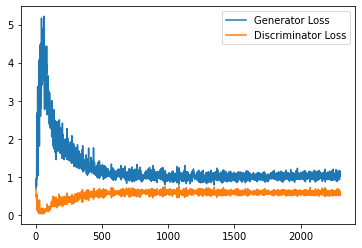

Step 46500: Generator loss: 1.0436873743534087, discriminator loss: 0.5765192060470581


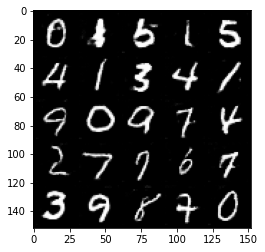

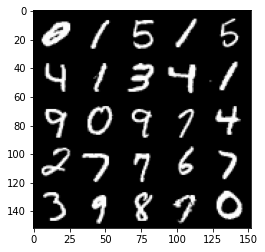

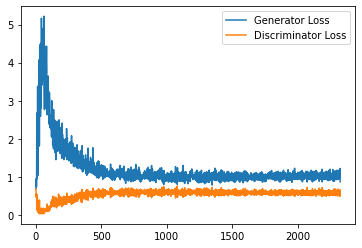

Step 47000: Generator loss: 1.0464913724660874, discriminator loss: 0.5725515597462654


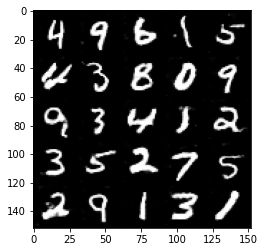

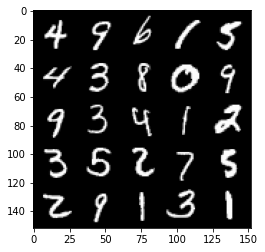

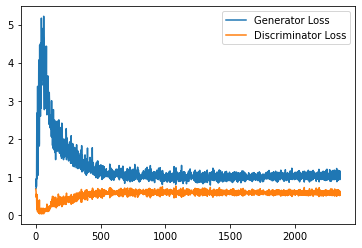

Step 47500: Generator loss: 1.0337090204954147, discriminator loss: 0.5792439372539521


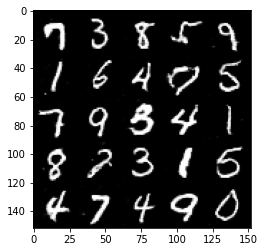

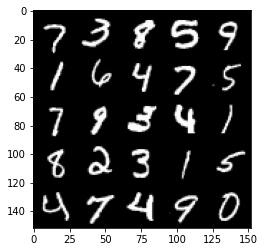

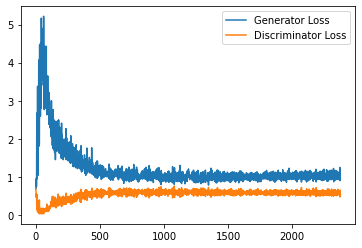

Step 48000: Generator loss: 1.0516527646780014, discriminator loss: 0.5778658378720284


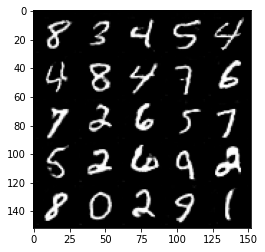

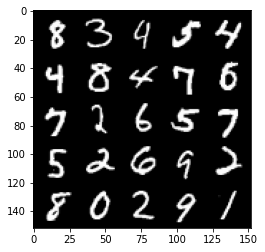

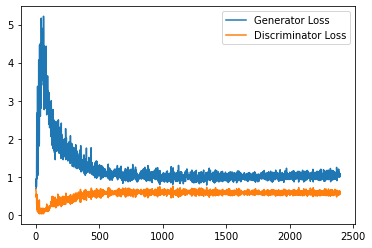

Step 48500: Generator loss: 1.0235746668577195, discriminator loss: 0.5811168793439865


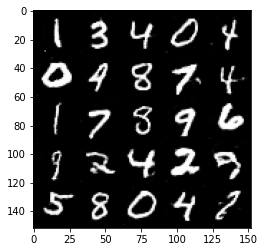

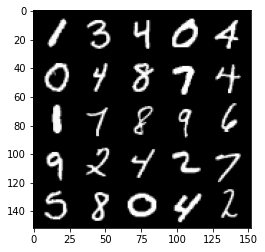

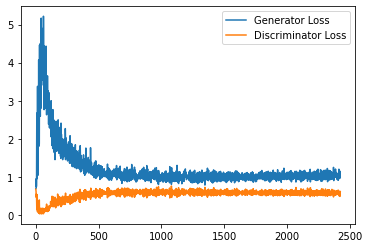

Step 49000: Generator loss: 1.0311214072704316, discriminator loss: 0.572996189236641


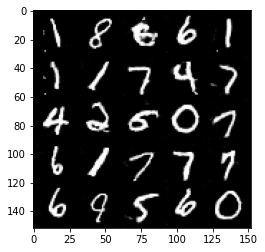

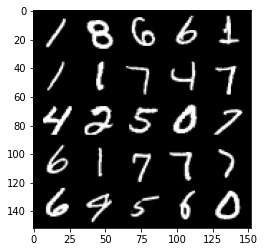

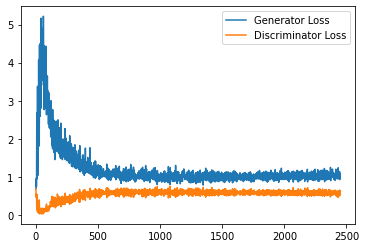

Step 49500: Generator loss: 1.047235503911972, discriminator loss: 0.5764780440926551


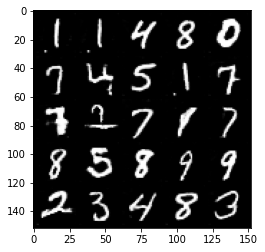

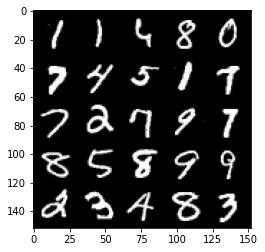

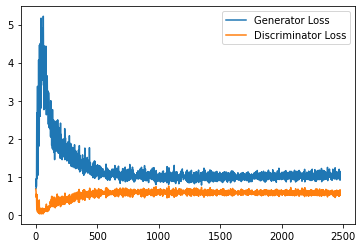

Step 50000: Generator loss: 1.0533858641386031, discriminator loss: 0.573020307123661


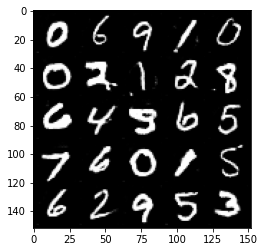

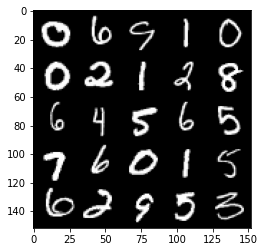

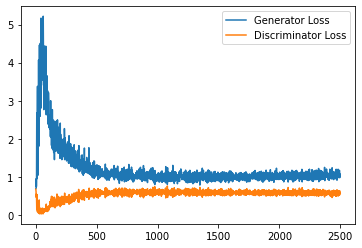

Step 50500: Generator loss: 1.0459085954427718, discriminator loss: 0.582138850569725


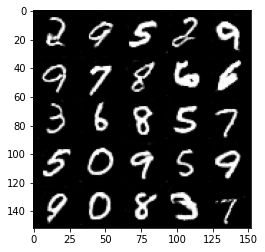

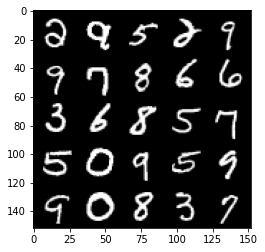

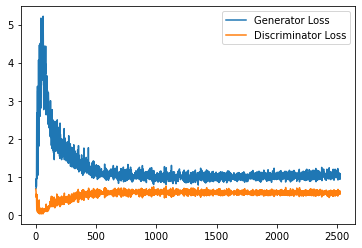

Step 51000: Generator loss: 1.03545063829422, discriminator loss: 0.5782774239182472


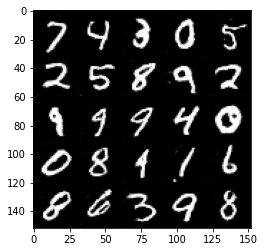

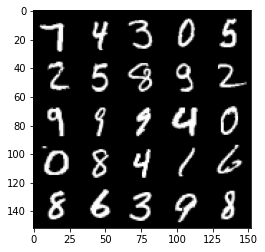

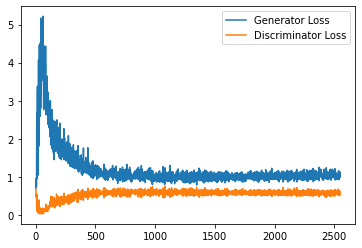

Step 51500: Generator loss: 1.0391087437868118, discriminator loss: 0.5810326415896415


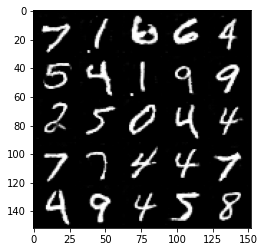

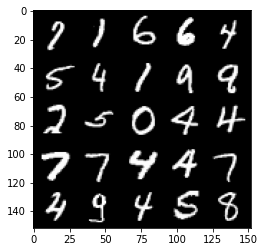

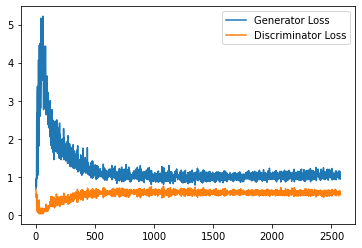

Step 52000: Generator loss: 1.0381368149518966, discriminator loss: 0.5795489895939827


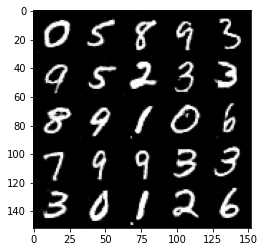

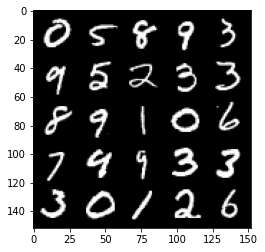

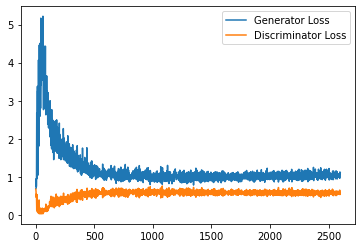

Step 52500: Generator loss: 1.0403592324256896, discriminator loss: 0.5885010911822319


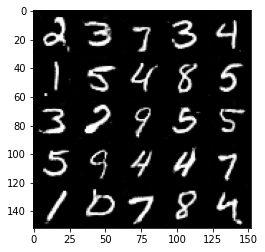

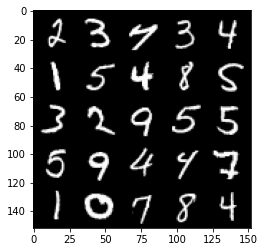

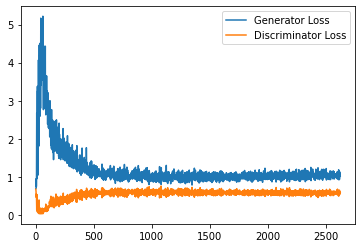

Step 53000: Generator loss: 1.0594923905134201, discriminator loss: 0.5768146829009057


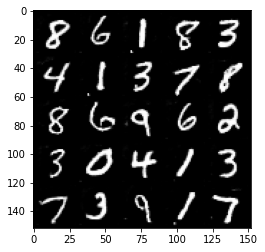

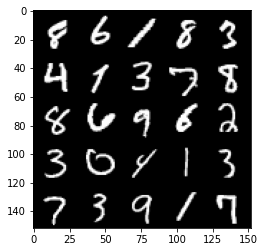

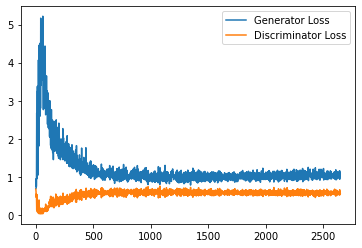

Step 53500: Generator loss: 1.0545629061460495, discriminator loss: 0.5822074837088584


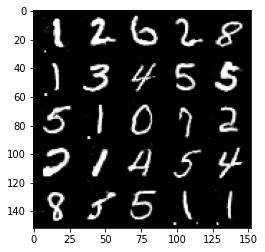

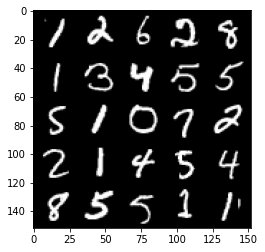

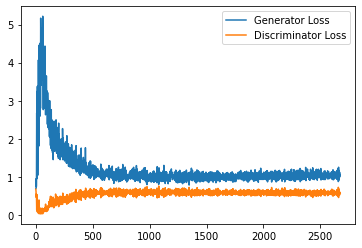

Step 54000: Generator loss: 1.0486537245512009, discriminator loss: 0.5827985851764679


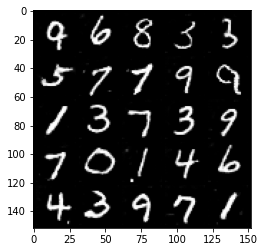

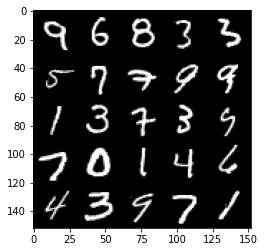

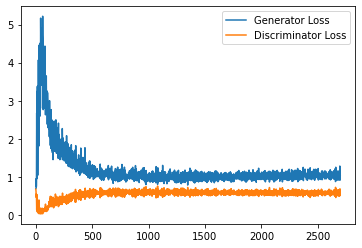

Step 54500: Generator loss: 1.0367117598056794, discriminator loss: 0.579849970817566


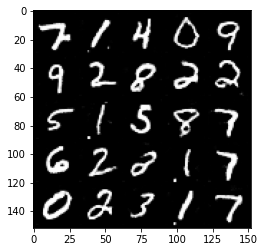

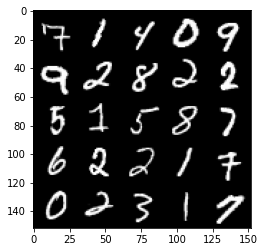

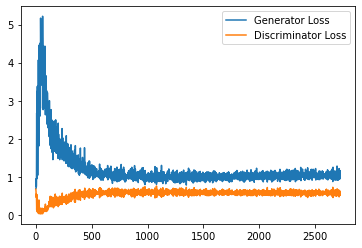

Step 55000: Generator loss: 1.046370839715004, discriminator loss: 0.5821442987322807


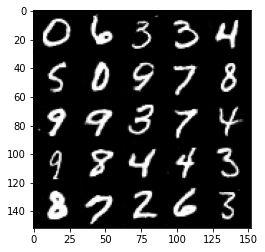

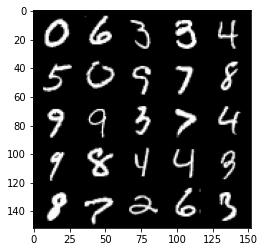

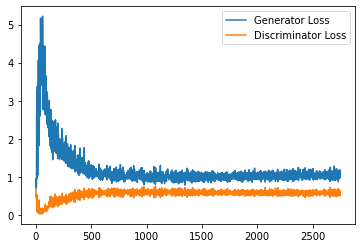

Step 55500: Generator loss: 1.0386769559383393, discriminator loss: 0.5827231948971748


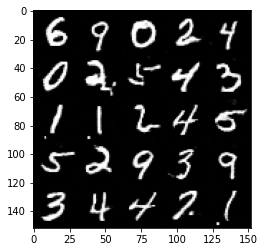

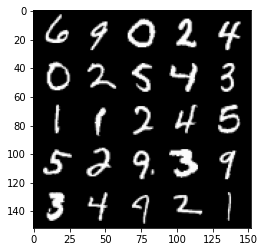

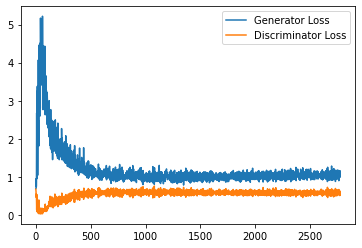

Step 56000: Generator loss: 1.0829354985952377, discriminator loss: 0.5738901845216751


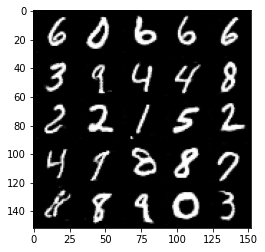

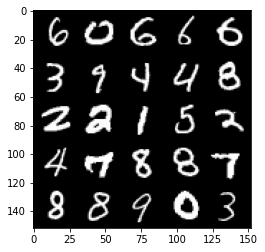

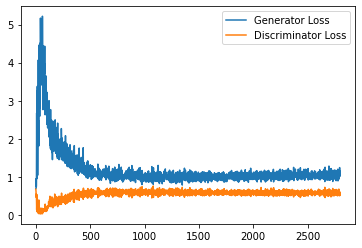

Step 56500: Generator loss: 1.0647156336307526, discriminator loss: 0.5771234565377236


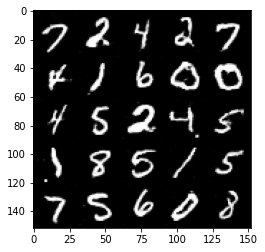

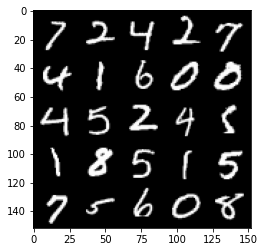

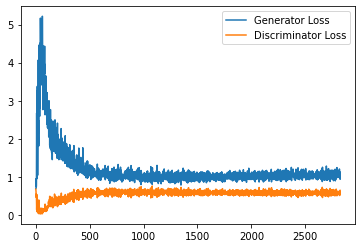

Step 57000: Generator loss: 1.0617545421123504, discriminator loss: 0.5739869093298912


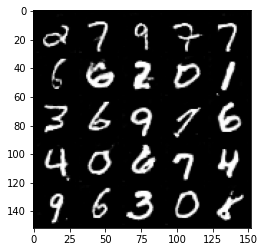

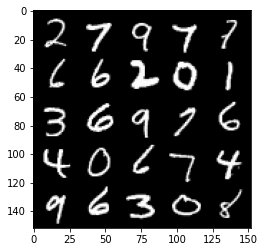

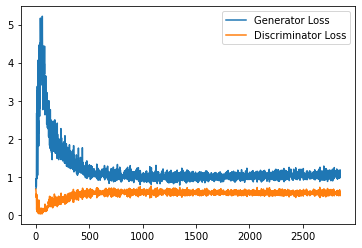

Step 57500: Generator loss: 1.038808799624443, discriminator loss: 0.5791378721594811


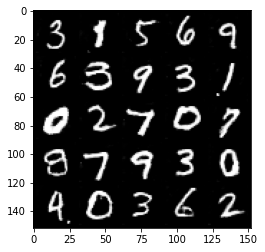

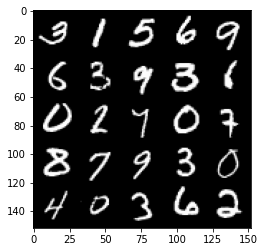

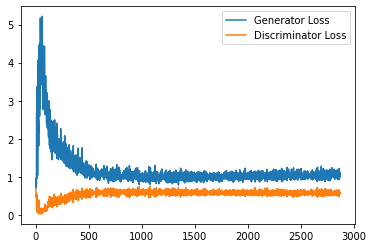

Step 58000: Generator loss: 1.0424023336172104, discriminator loss: 0.5839991310238838


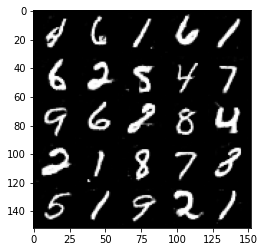

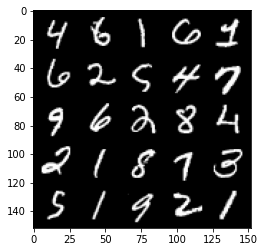

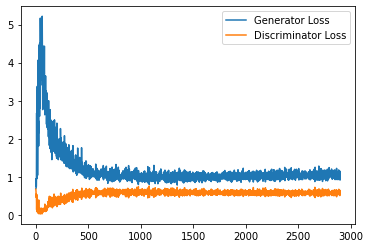

Step 58500: Generator loss: 1.0465773282051087, discriminator loss: 0.5786366662979125


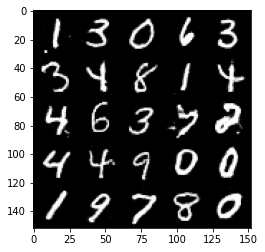

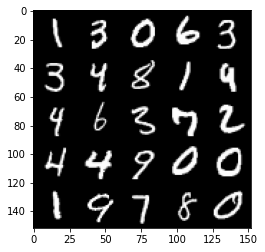

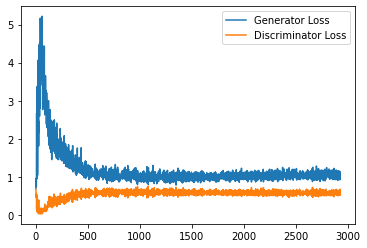

Step 59000: Generator loss: 1.0408830295801164, discriminator loss: 0.578403876721859


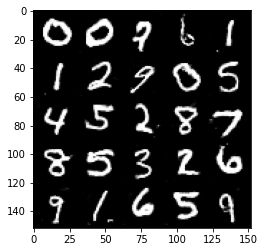

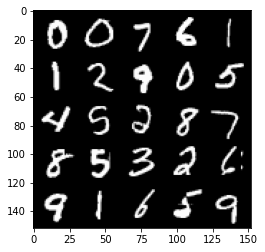

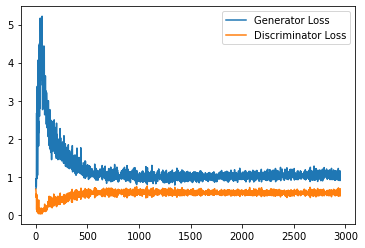

Step 59500: Generator loss: 1.0663091381788254, discriminator loss: 0.5817980753183365


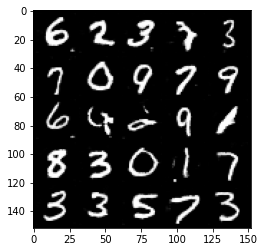

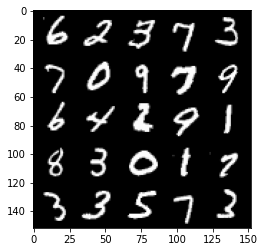

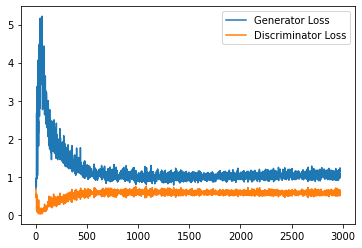

Step 60000: Generator loss: 1.0589158602952957, discriminator loss: 0.5946962899565696


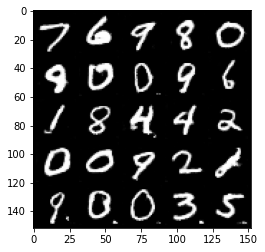

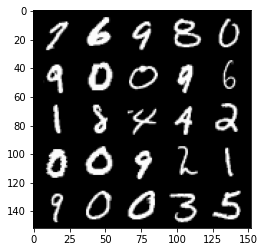

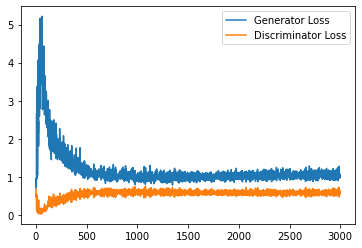

Step 60500: Generator loss: 1.0503358328342438, discriminator loss: 0.5796887312531471


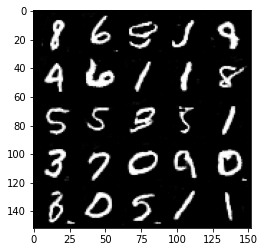

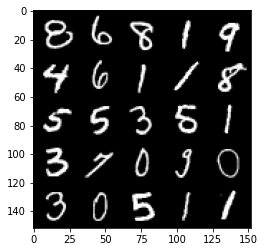

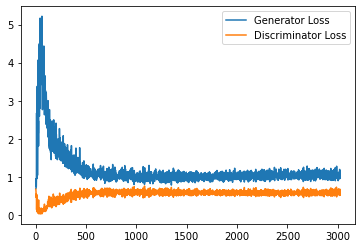

Step 61000: Generator loss: 1.0494622898101806, discriminator loss: 0.5873204736113549


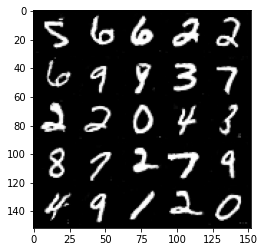

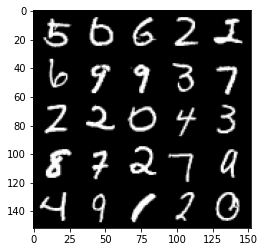

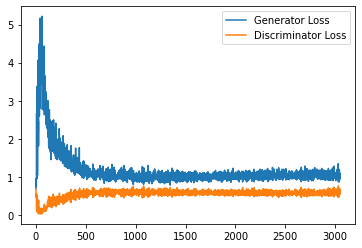

Step 61500: Generator loss: 1.047662623643875, discriminator loss: 0.5827100980877876


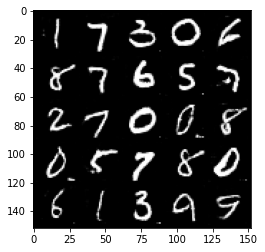

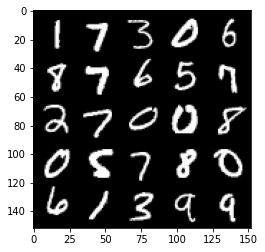

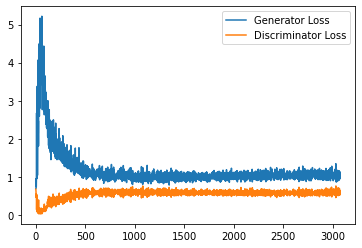

Step 62000: Generator loss: 1.0475472412109375, discriminator loss: 0.5849606956839561


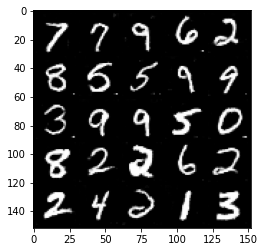

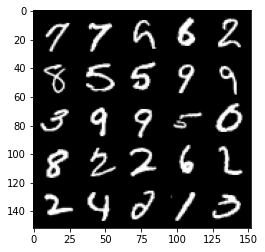

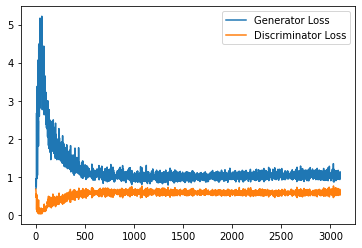

Step 62500: Generator loss: 1.0586848776340485, discriminator loss: 0.594084032356739


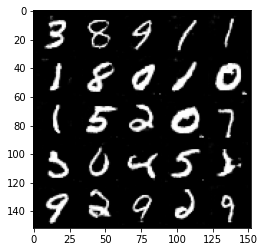

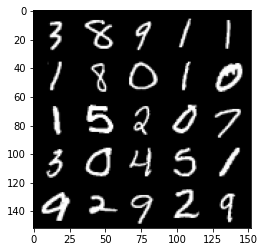

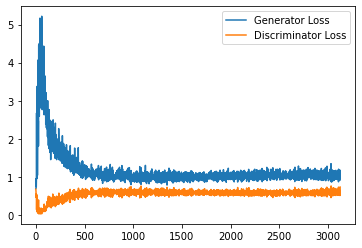

Step 63000: Generator loss: 1.0359785615205765, discriminator loss: 0.5854364062547683


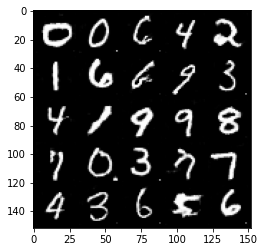

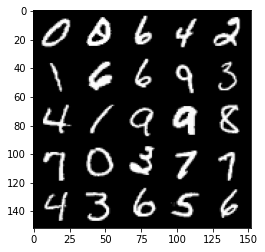

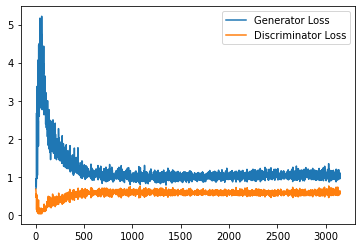

Step 63500: Generator loss: 1.0298369575738906, discriminator loss: 0.5830461386442184


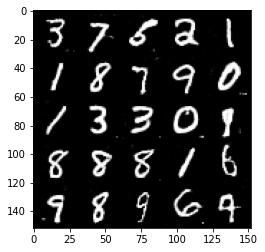

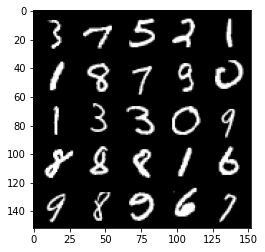

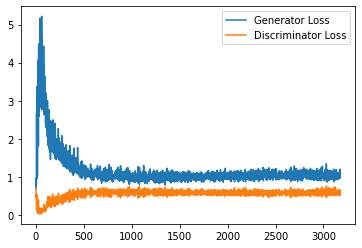

Step 64000: Generator loss: 1.0309569076299667, discriminator loss: 0.591034110724926


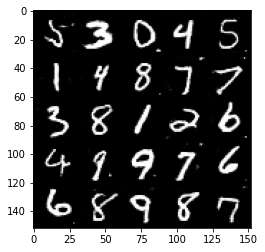

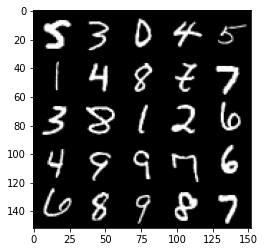

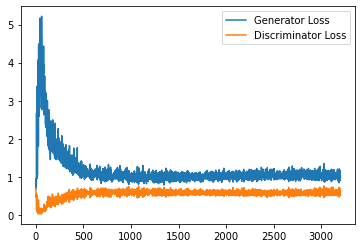

Step 64500: Generator loss: 1.0417006878852844, discriminator loss: 0.5838028510212898


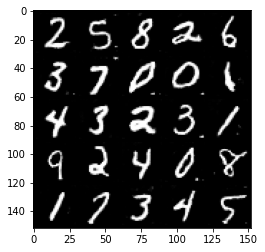

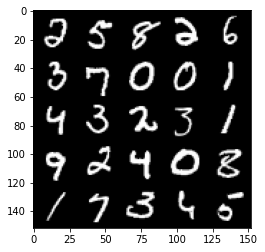

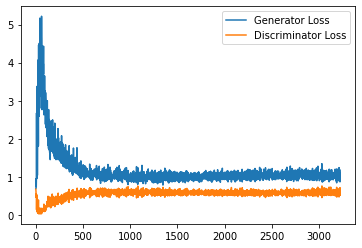

Step 65000: Generator loss: 1.0380817558765412, discriminator loss: 0.5907059416174889


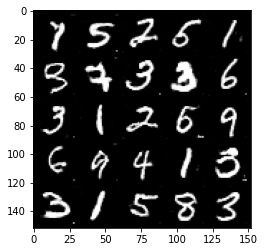

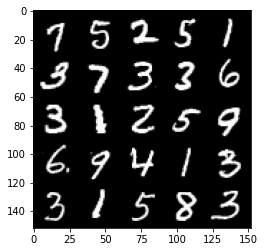

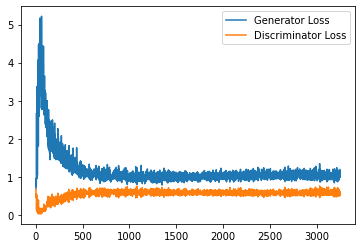

Step 65500: Generator loss: 1.0313211767673491, discriminator loss: 0.5950794687867165


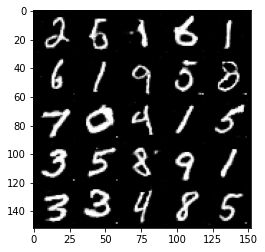

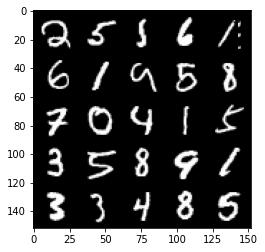

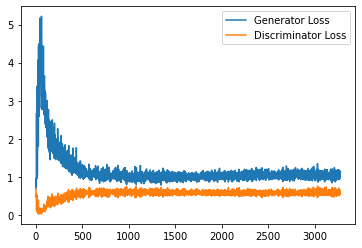

Step 66000: Generator loss: 1.0357228554487228, discriminator loss: 0.5932354014515877


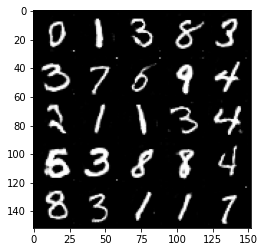

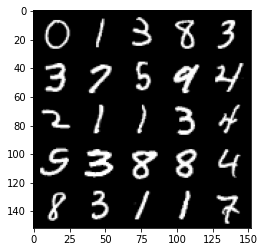

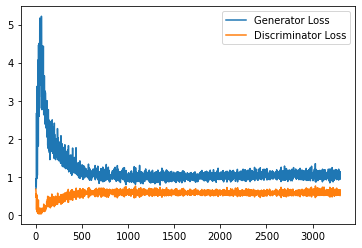

Step 66500: Generator loss: 1.0159663064479827, discriminator loss: 0.595073534488678


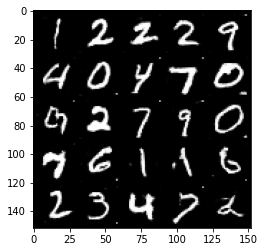

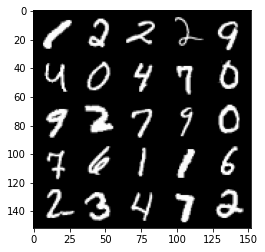

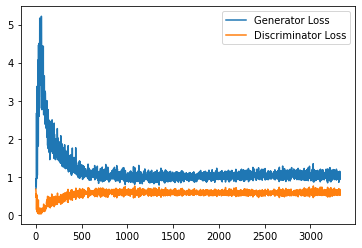

Step 67000: Generator loss: 1.0159155131578446, discriminator loss: 0.5921320457458497


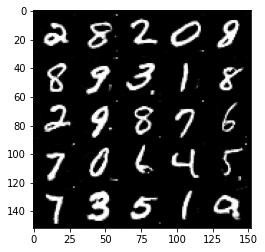

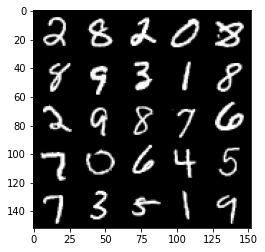

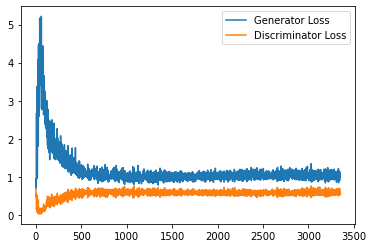

Step 67500: Generator loss: 1.0373003865480424, discriminator loss: 0.5939965518116951


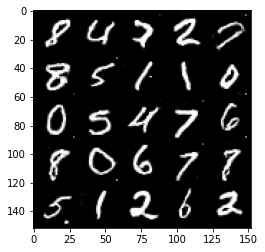

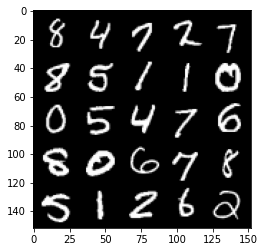

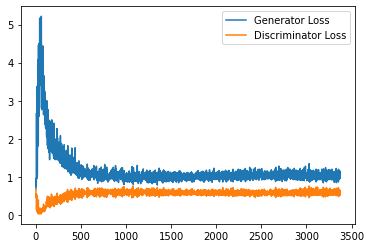

Step 68000: Generator loss: 1.0369039472341537, discriminator loss: 0.597570615708828


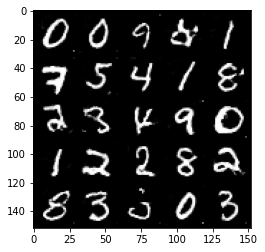

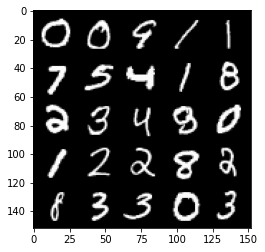

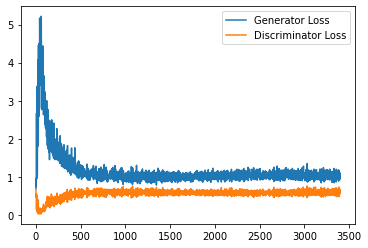

Step 68500: Generator loss: 1.0335458407402038, discriminator loss: 0.5951391740441322


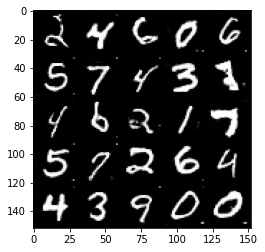

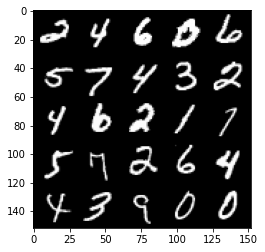

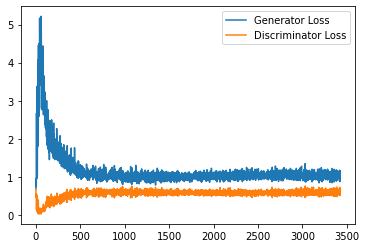

Step 69000: Generator loss: 1.0158768912553788, discriminator loss: 0.5980598818659782


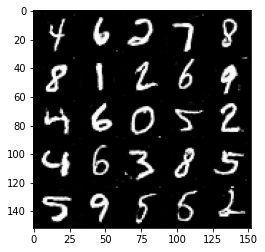

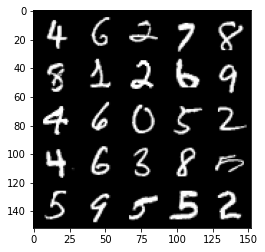

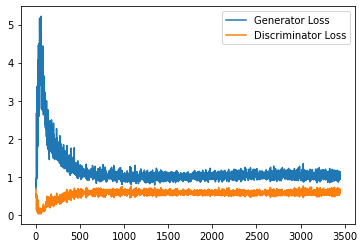

Step 69500: Generator loss: 1.0296242364645005, discriminator loss: 0.5929740601181984


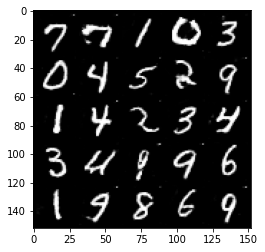

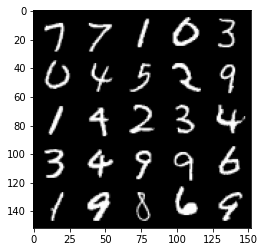

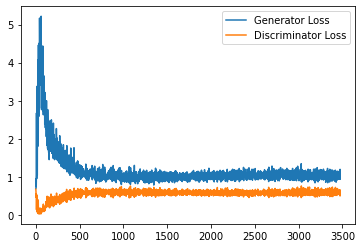

Step 70000: Generator loss: 1.029940768122673, discriminator loss: 0.5909944331049919


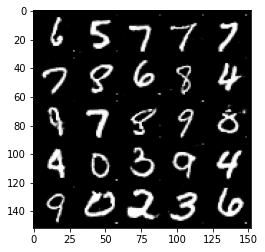

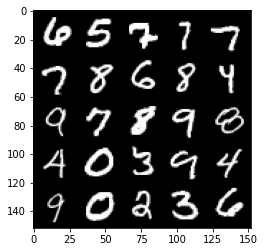

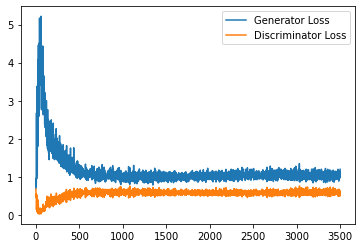

Step 70500: Generator loss: 1.0128417747020722, discriminator loss: 0.5994725760817528


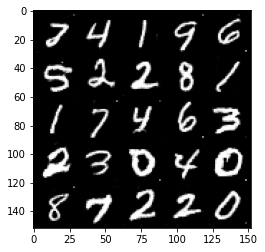

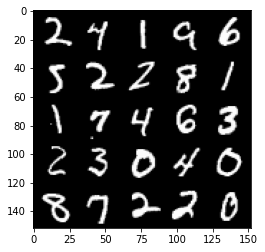

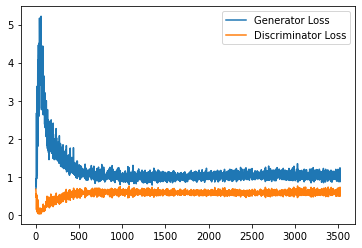

Step 71000: Generator loss: 1.0204178426265718, discriminator loss: 0.5940616518259049


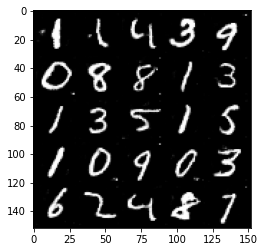

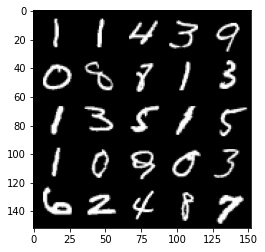

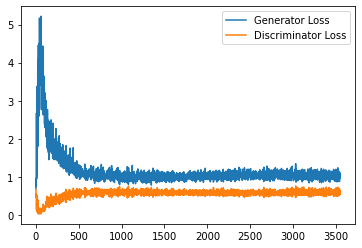

Step 71500: Generator loss: 1.02092165350914, discriminator loss: 0.5960579932928085


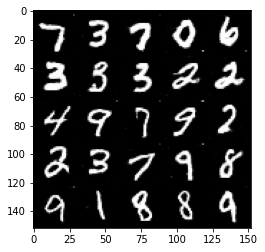

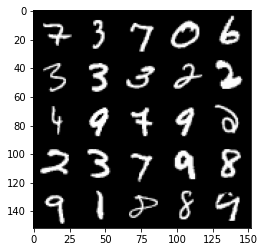

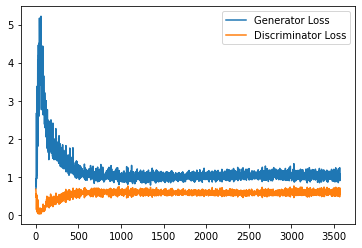

Step 72000: Generator loss: 1.0248729951381683, discriminator loss: 0.5948664226531982


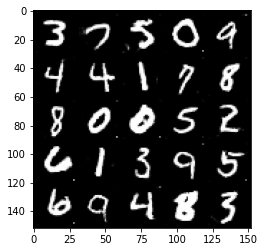

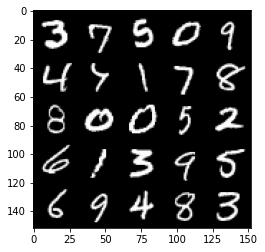

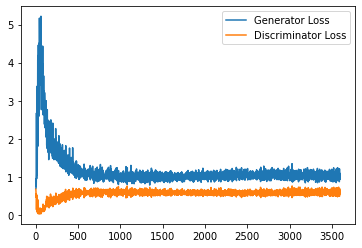

Step 72500: Generator loss: 1.0230224043130876, discriminator loss: 0.5983049141168595


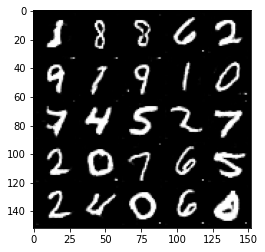

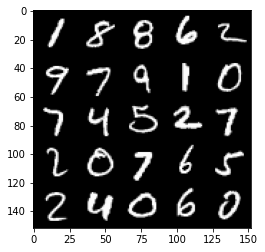

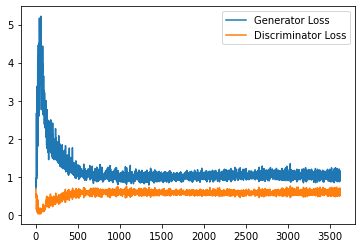

Step 73000: Generator loss: 1.0168397805690765, discriminator loss: 0.6010941584706306


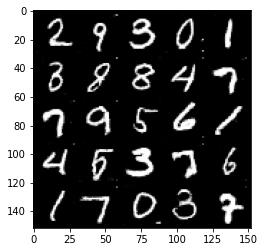

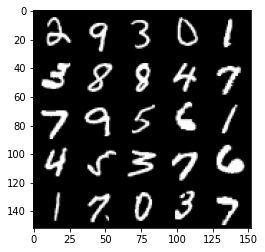

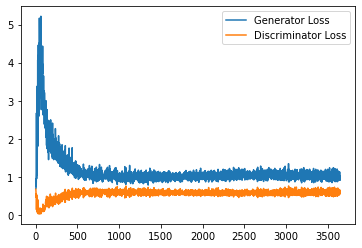

Step 73500: Generator loss: 1.0215402388572692, discriminator loss: 0.5946698545217514


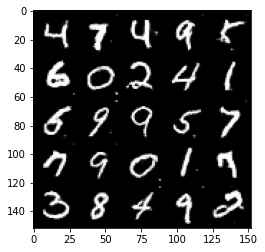

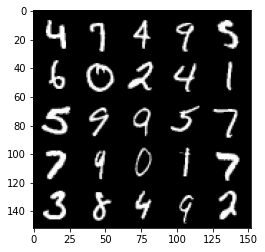

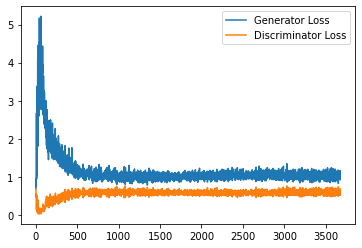

Step 74000: Generator loss: 1.0185866503715515, discriminator loss: 0.6026623900532723


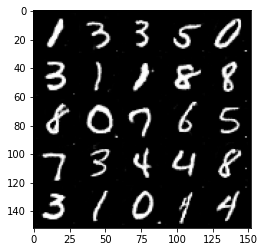

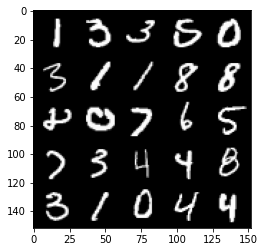

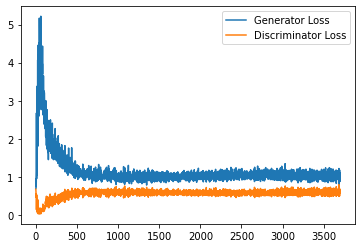

Step 74500: Generator loss: 1.009567090511322, discriminator loss: 0.5988683739900589


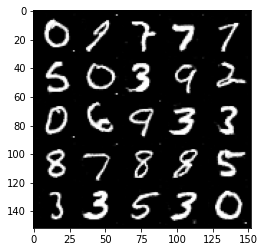

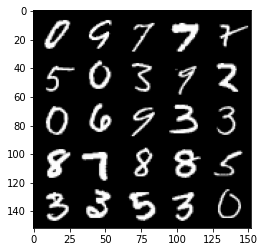

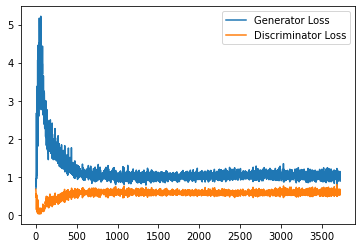

Step 75000: Generator loss: 1.0330023040771485, discriminator loss: 0.5985664852261543


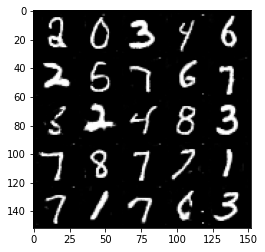

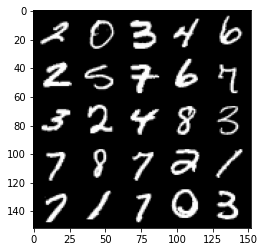

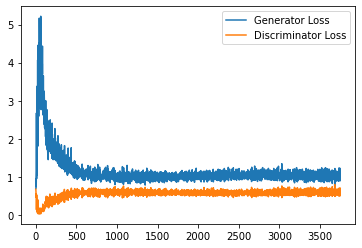

Step 75500: Generator loss: 1.0308188152313233, discriminator loss: 0.5996127433180809


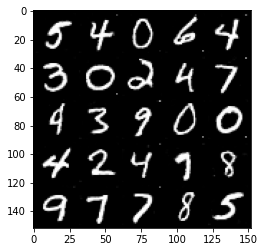

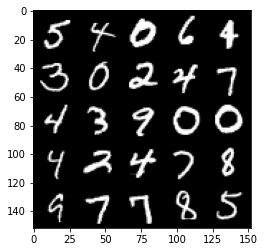

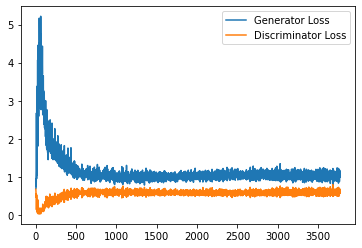

Step 76000: Generator loss: 1.0045477800369262, discriminator loss: 0.5979307539463043


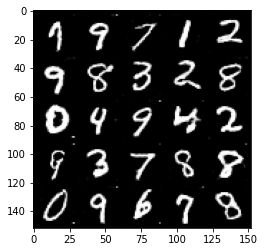

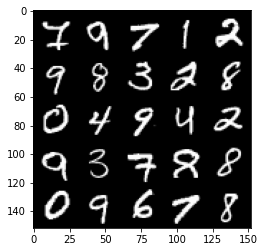

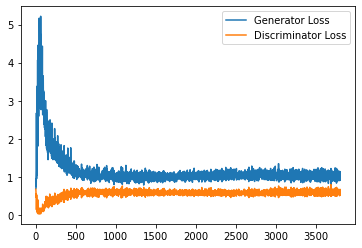

Step 76500: Generator loss: 1.0171913018226624, discriminator loss: 0.6024928938150406


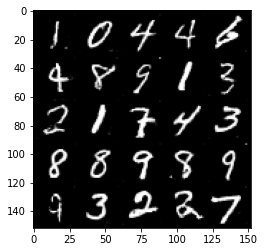

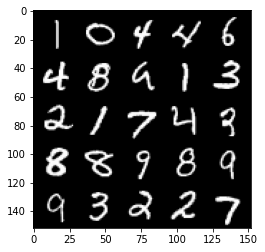

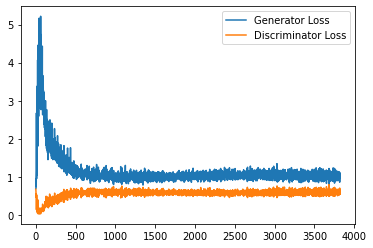

Step 77000: Generator loss: 1.012013916015625, discriminator loss: 0.5986419363021851


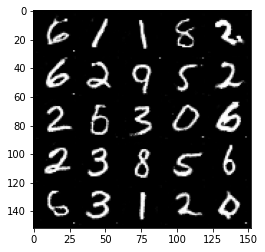

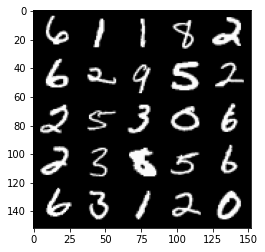

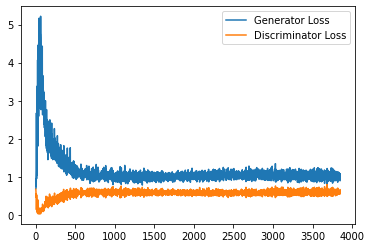

Step 77500: Generator loss: 1.0004973174333573, discriminator loss: 0.607857797384262


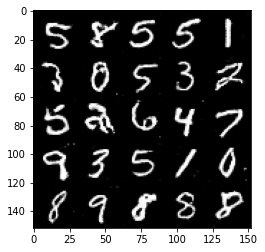

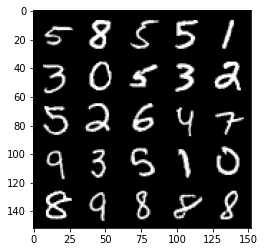

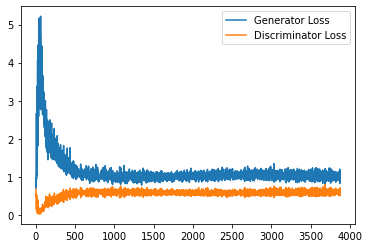

Step 78000: Generator loss: 1.0086160972118379, discriminator loss: 0.6008330709338188


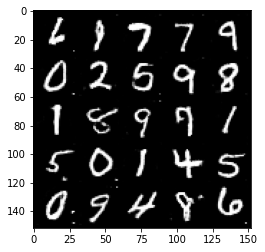

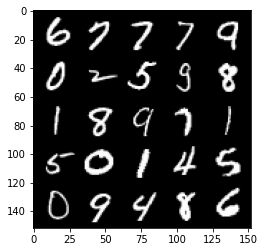

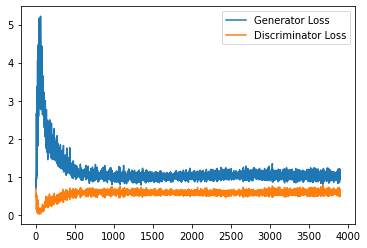

Step 78500: Generator loss: 1.006745952963829, discriminator loss: 0.5972110950350762


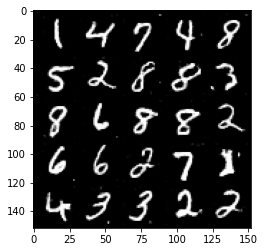

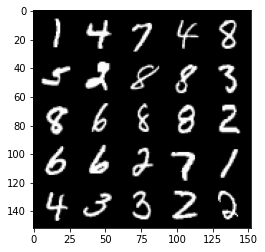

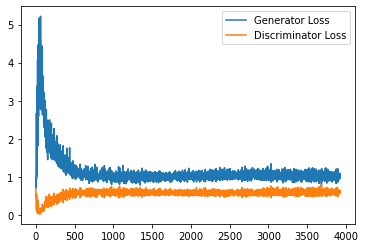

Step 79000: Generator loss: 1.013967203259468, discriminator loss: 0.5994475876688957


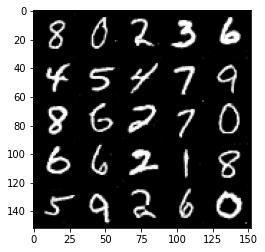

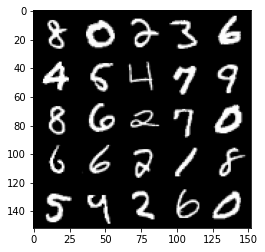

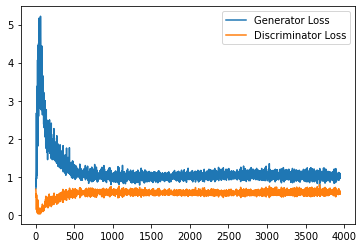

Step 79500: Generator loss: 1.0112723172903062, discriminator loss: 0.6062711238265037


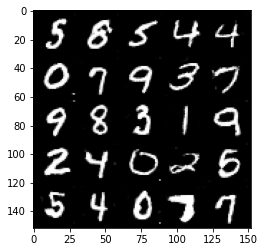

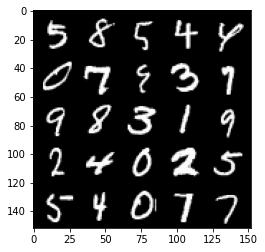

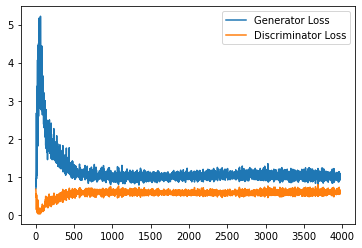

Step 80000: Generator loss: 1.0245390747785568, discriminator loss: 0.6060699148774147


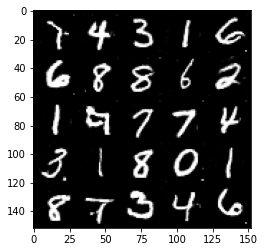

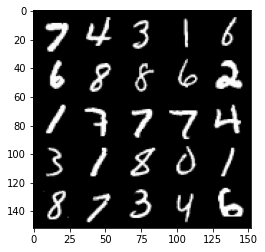

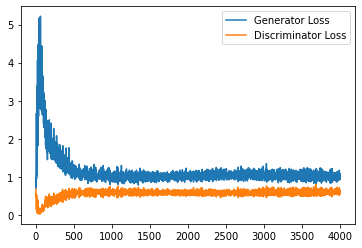

Step 80500: Generator loss: 1.0131979452371598, discriminator loss: 0.6049283317923546


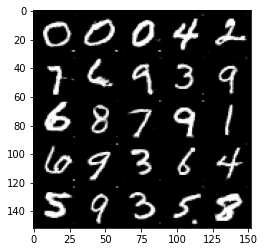

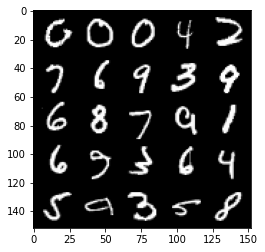

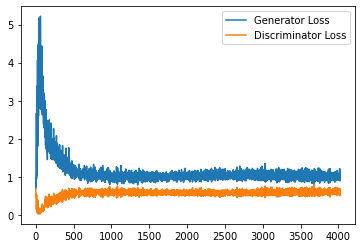

Step 81000: Generator loss: 1.0070654082298278, discriminator loss: 0.6050407913923264


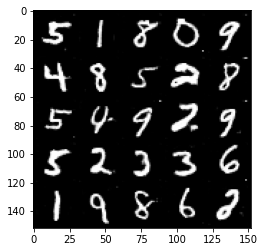

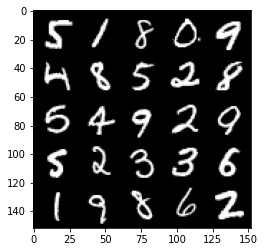

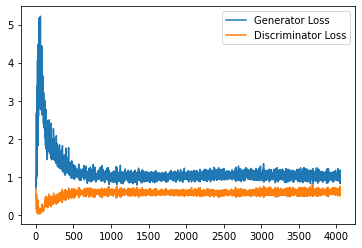

Step 81500: Generator loss: 0.9977283664941787, discriminator loss: 0.6049901187419892


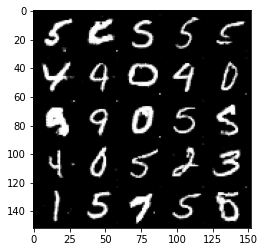

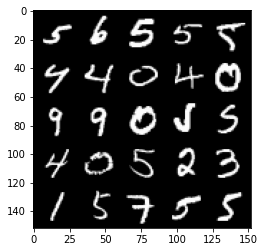

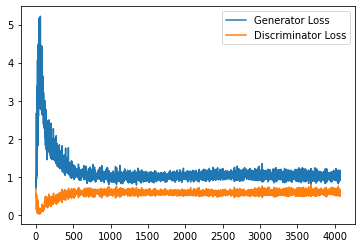

Step 82000: Generator loss: 1.0183297824859618, discriminator loss: 0.5989231021404267


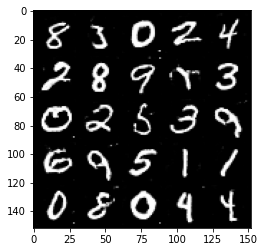

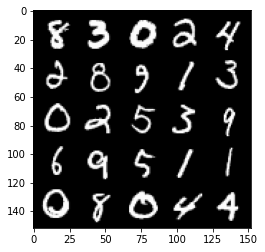

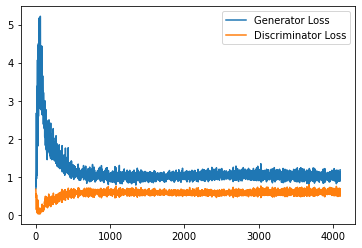

Step 82500: Generator loss: 0.9999049849510193, discriminator loss: 0.6078778169155121


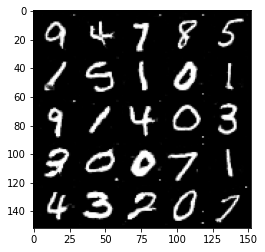

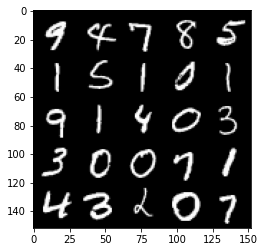

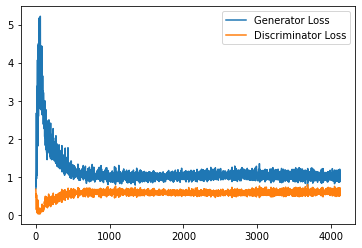

Step 83000: Generator loss: 1.0033067172765733, discriminator loss: 0.6006369448900223


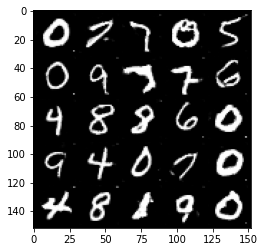

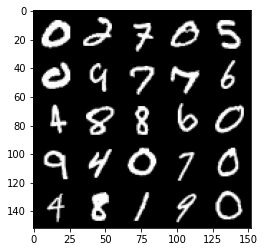

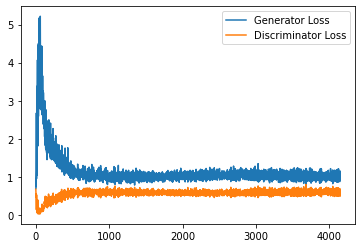

Step 83500: Generator loss: 1.006657436490059, discriminator loss: 0.6084845569133759


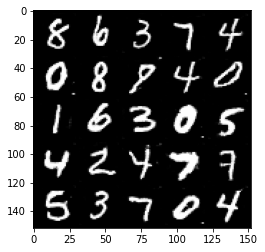

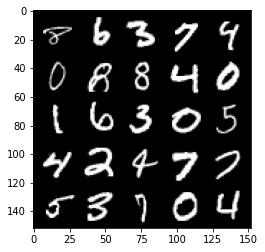

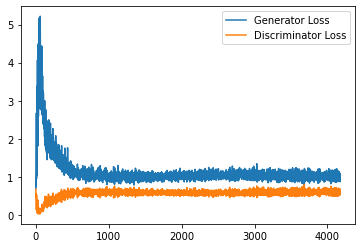

Step 84000: Generator loss: 1.0215857852697372, discriminator loss: 0.6058728095889091


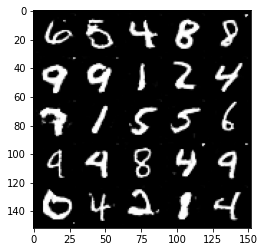

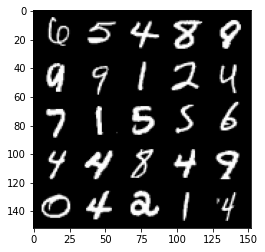

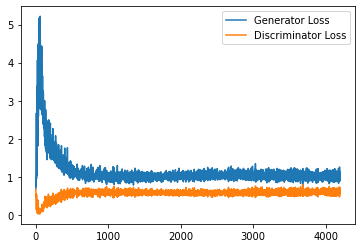

Step 84500: Generator loss: 1.0248589017391205, discriminator loss: 0.6118555151224137


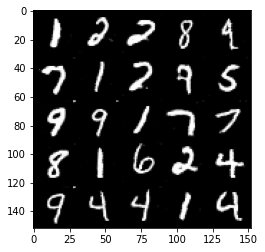

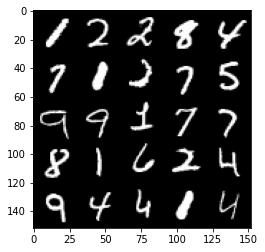

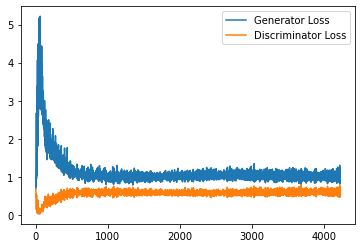

Step 85000: Generator loss: 0.9920723522901536, discriminator loss: 0.6089187065958976


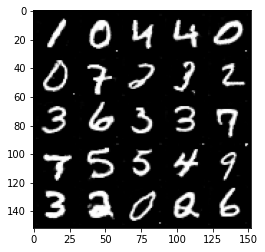

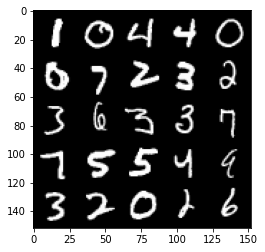

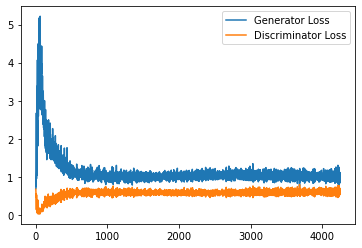

Step 85500: Generator loss: 1.0046731522083283, discriminator loss: 0.5995526179075241


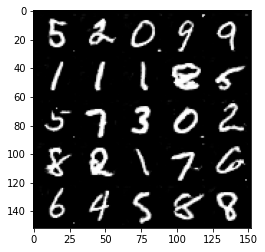

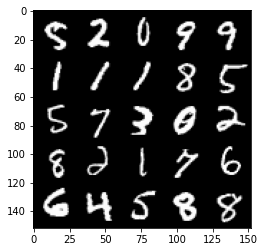

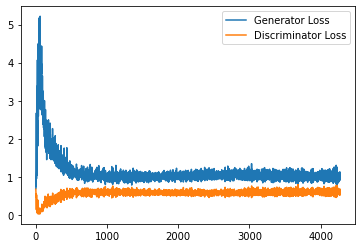

Step 86000: Generator loss: 1.0097916071414947, discriminator loss: 0.604370624780655


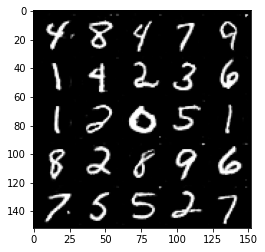

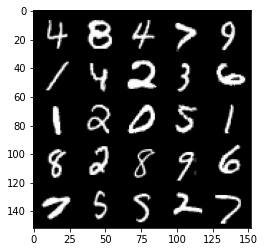

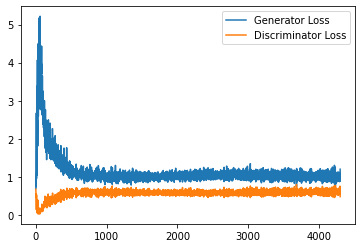

Step 86500: Generator loss: 0.9883698152303696, discriminator loss: 0.6138002678751946


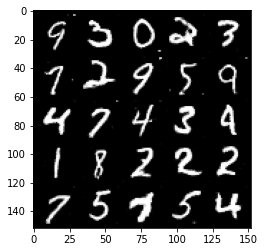

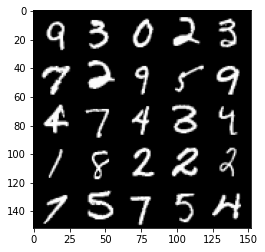

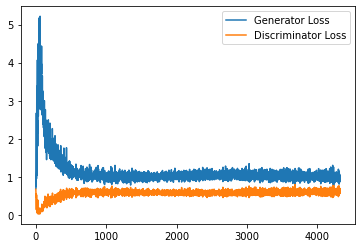

Step 87000: Generator loss: 0.996128310084343, discriminator loss: 0.6019036337733269


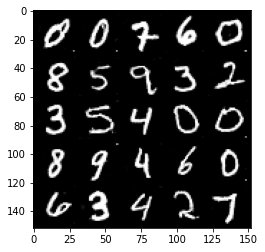

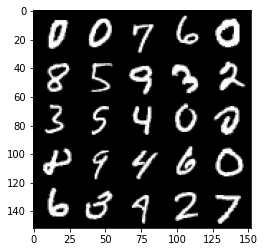

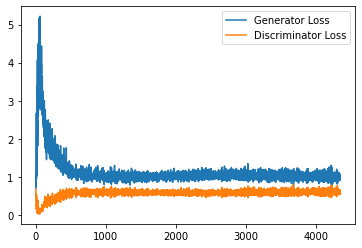

Step 87500: Generator loss: 0.9888675833940506, discriminator loss: 0.6063357592225075


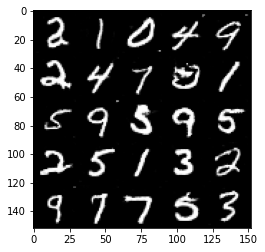

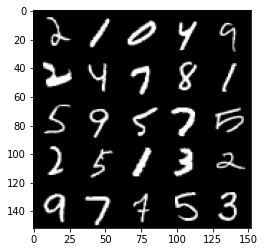

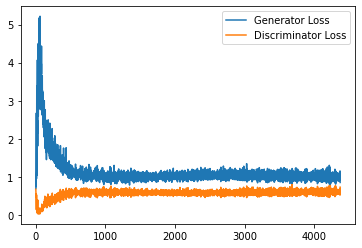

Step 88000: Generator loss: 0.9892688671350479, discriminator loss: 0.6063387944102288


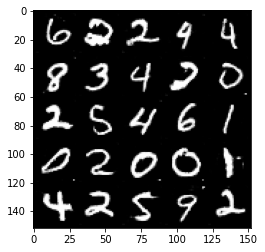

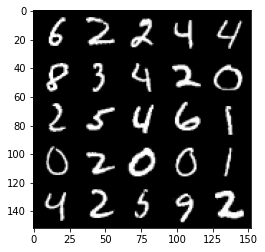

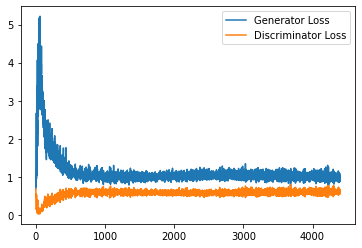

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [23]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [24]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

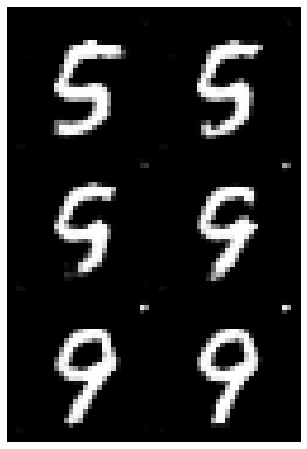

In [28]:
import math

### Change me! ###
n_interpolation = 6# Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 5 # Choose the start digit
### Change me! ###
end_plot_number = 9 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

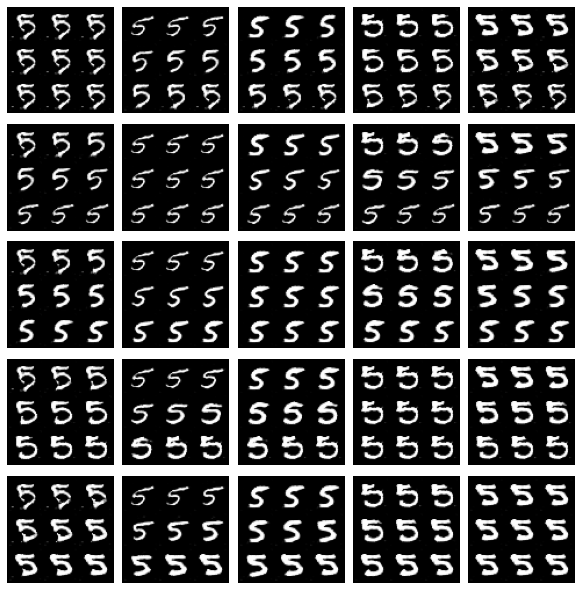

In [29]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()